## Advanced Lane Detection

#### Importing the relevant libraries

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob 
% matplotlib inline

#### Defining Classes & Functions

In [2]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None  

In [3]:
# Returns the undistorted image given the camera 
# matrix & distortion coefficients
def undistort_image(img, mtx, dist):
    return cv2.undistort(img, mtx, dist, None, mtx)


# Define a function that applies Sobel x or y, 
# then takes an absolute value and applies a threshold.
def abs_sobel_thresh(img, orient, sobel_kernel=3, thresh=(0, 255)):  
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    # Return the result
    return binary_output

def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):

    # Apply the following steps to img
    # 1) Convert to grayscale
    # 2) Take the gradient in x and y separately
    # 3) Calculate the magnitude 
    # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    # 5) Create a binary mask where mag thresholds are met
    # 6) Return this mask as your binary_output image
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    return binary_output

def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):

    # Apply the following steps to img
    # 1) Convert to grayscale
    # 2) Take the gradient in x and y separately
    # 3) Take the absolute value of the x and y gradients
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    # 5) Create a binary mask where direction thresholds are met
    # 6) Return this mask as your binary_output image
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    return binary_output

# Edit this function to create your own pipeline.
def hls_threshold(img, s_thresh=(170, 245), sx_thresh=(20, 100)):
    img = np.copy(img)
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))

    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1

    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    # Stack each channel

    return sxbinary, s_binary

#### Perspective transform

def transform_image(img): 


    # Grab the image shape
    img_size = (img.shape[1], img.shape[0])

    leftupperpoint  = [570,470]
    rightupperpoint = [720,470]
    leftlowerpoint  = [260,680]
    rightlowerpoint = [1045,680]
    src = np.float32([leftupperpoint, leftlowerpoint, rightupperpoint, rightlowerpoint])
    dst = np.float32([[200,0], [200,680], [1000,0], [1000,680]])

    # Given src and dst points, calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_NEAREST)

    return warped, M

#####lane pixels

def find_lane_pixels(warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(warped[warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out1_img = np.dstack((warped, warped, warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = warped.shape[0] - (window+1)*window_height
        win_y_high = warped.shape[0] - window*window_height
        ### TO-DO: Find the four below boundaries of the window ###
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin

        # Draw the windows on the visualization image
      # Draw the windows on the visualization image
        cv2.rectangle(out1_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out1_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        #plt.imshow(out1_img)

        ### TO-DO: Identify the nonzero pixels in x and y within the window ###
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
            (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
            (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]


        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)


        ### TO-DO: If you found > minpix pixels, recenter next window ###
        ### (`right` or `leftx_current`) on their mean position ###
        if len(good_left_inds) > minpix:
                leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
                rightx_current = np.int(np.mean(nonzerox[good_right_inds]))


    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass


    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]



    return leftx, lefty, rightx, righty, out1_img

def fit_polynomial(warped):
# Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(warped)

    ### TO-DO: Fit a second order polynomial to each using `np.polyfit` ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]



    #print('IM here')
    # Plot the result
    #f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    #f.tight_layout()

    #ax1.imshow(image)
    #ax1.set_title('Original Image', fontsize=40)

    #ax2.imshow(out_img)
        # Plots the left and right polynomials on the lane lines
    #ax2.plot(left_fitx, ploty, color='yellow')
    #ax2.plot(right_fitx, ploty, color='yellow')
    #ax2.set_title('Pipeline Result', fontsize=40)
    #plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

    return out_img,left_fit,right_fit

def radius_curvature(warped, left_fit, right_fit):

    ploty = np.linspace(0,warped.shape[0]-1,warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    y_eval = np.max(ploty)

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)

    # Calculate the new radii of curvature
    left_curvature =  ((1 + (2*left_fit_cr[0] *y_eval*ym_per_pix + left_fit_cr[1])**2) **1.5) / np.absolute(2*left_fit_cr[0])
    right_curvature = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])

    # Calculate vehicle center
    #left_lane and right lane bottom in pixels
    left_lane_bottom = (left_fit[0]*y_eval)**2 + left_fit[0]*y_eval + left_fit[2]
    right_lane_bottom = (right_fit[0]*y_eval)**2 + right_fit[0]*y_eval + right_fit[2]

    # Lane center as mid of left and right lane bottom                        
    lane_center = (left_lane_bottom + right_lane_bottom)/2.
    avg_curvature = (left_curvature + right_curvature)/2.
    center_image = 640
    center = (lane_center - center_image)*xm_per_pix #Convert to meters
    position = "left" if center < 0 else "right"
    center = "Vehicle is {:.2f}m {} of center".format(center, position)
    curve = "Radius of Curvature = {:.2f}(m)".format(avg_curvature)

    # Now our radius of curvature is in meters
    return left_curvature, right_curvature, center, curve, ploty,left_fitx,right_fitx

In [4]:
images = glob.glob('camera_cal/calibration*.jpg')
nx = 9
ny = 6
objpoints = []
imgpoints = []
objp = np.zeros((9*6,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

for fname in images:
    
    img = mpimg.imread(fname)

    # Convert to grayscale
    undist = np.copy(img)  # Delete this line
    gray = cv2.cvtColor(undist,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
    # If found, draw corners
   
    if ret == True:
        imgpoints.append(corners)
        objpoints.append(objp)
        # Draw and display the corners

        cv2.drawChessboardCorners(undist, (nx, ny), corners, ret)

Text(0.5,1,'Undistorted Images')

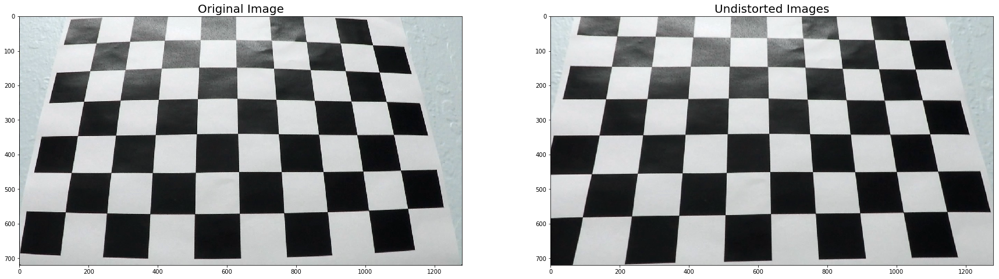

In [5]:
img = cv2.imread('camera_cal/calibration3.jpg')
img_size = (img.shape[1], img.shape[0])


ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)

dst = cv2.undistort(img, mtx, dist, None, mtx)

f, axes= plt.subplots(1,2,figsize=(30,30))


axes[0].imshow(img)
axes[0].set_title("Original Image", fontsize=20)
axes[1].imshow(dst)
axes[1].set_title("Undistorted Images", fontsize=20)

### Undistort main image


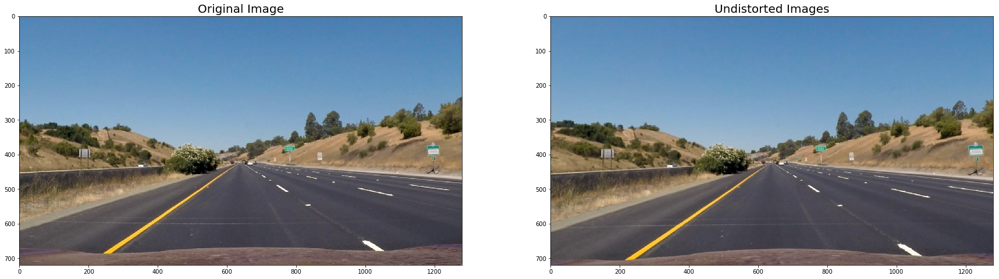

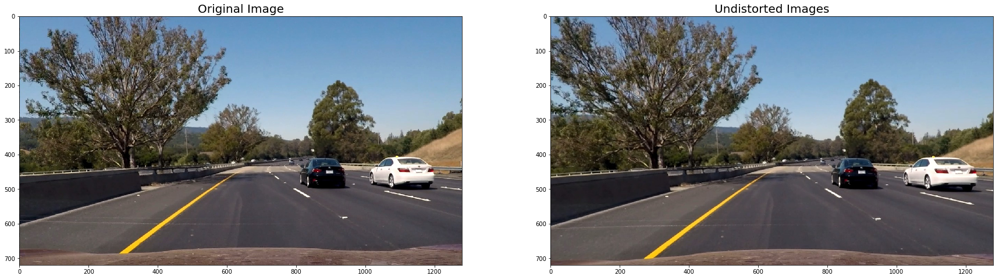

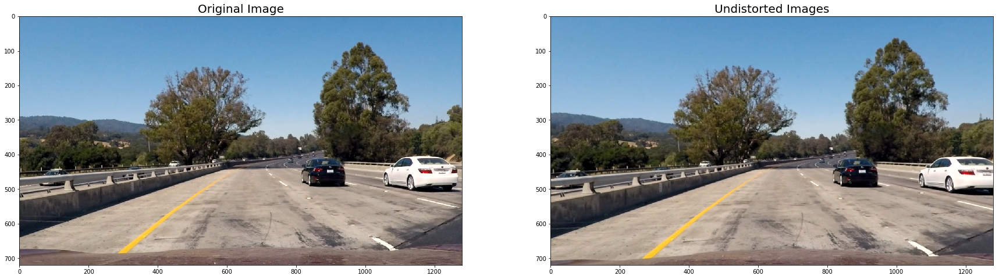

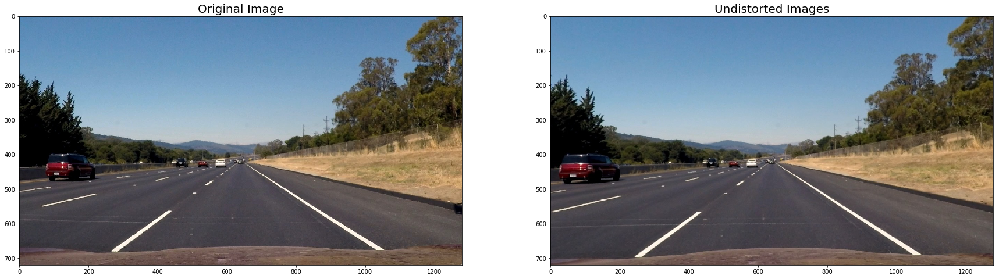

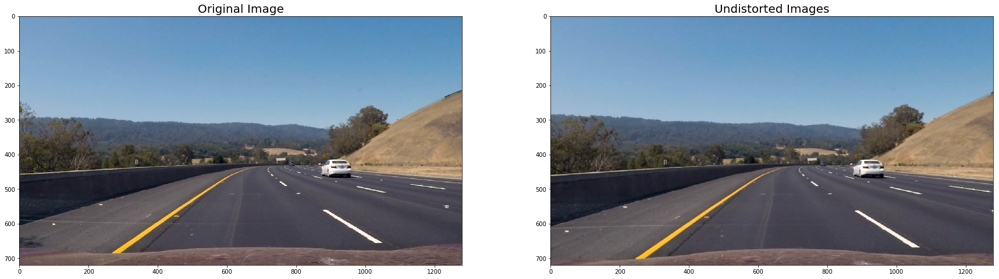

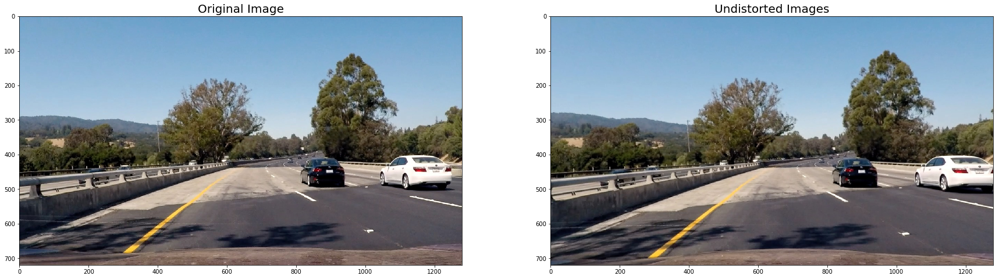

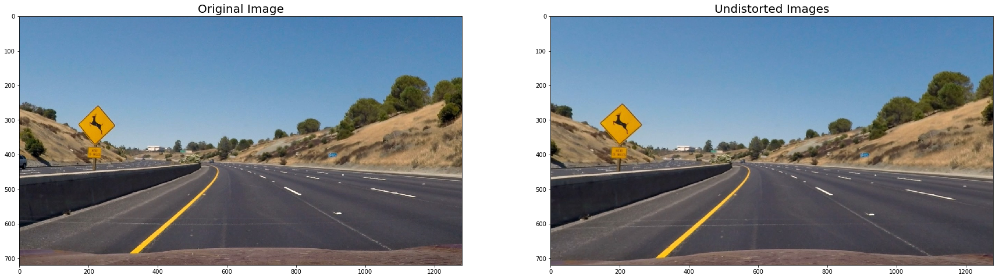

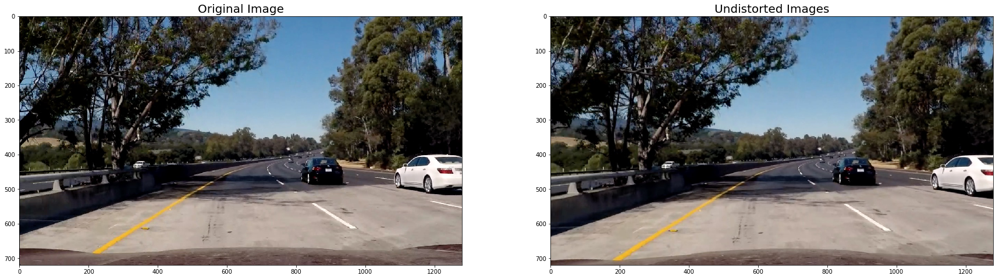

In [6]:
#def undistort_image(img, mtx, dist):
#    return cv2.undistort(img, mtx, dist, None, mtx)

for fname in glob.glob('test_images/*'):
    
    img = mpimg.imread(fname)
    undist_img = undistort_image(img, mtx, dist)
    f, axes= plt.subplots(1,2,figsize=(30,30))


    axes[0].imshow(img)
    axes[0].set_title("Original Image", fontsize=20)
    axes[1].imshow(undist_img)
    axes[1].set_title("Undistorted Images", fontsize=20)

## Color Spaces and Gradient Thresholding

[-2.64563966e-05  4.04807139e-02  1.88306986e+02] [ 9.68239648e-05 -5.90928392e-02  9.95613787e+02]
[ 1.02267966e-04 -2.24210791e-01  3.54368453e+02] [-7.52112426e-05 -7.87358116e-02  1.13790739e+03]
[ 1.34620570e-04 -1.20524060e-01  2.57812607e+02] [ 2.47301156e-04 -2.59004061e-01  1.12484430e+03]
[-2.32151613e-04  2.34745994e-01  1.54546224e+02] [ 1.44966748e-05 -1.40805415e-02  1.00548371e+03]
[ 9.30998580e-05 -2.12914637e-01  3.32506792e+02] [ 1.67871445e-04 -2.43668909e-01  1.12593742e+03]
[ 7.38211254e-05 -5.12853785e-02  2.62372402e+02] [ 2.42751869e-04 -2.41086089e-01  1.13342288e+03]
[-1.54524979e-04  2.59066267e-01  1.76896523e+02] [-5.23787487e-04  4.36391928e-01  9.56506171e+02]
[-1.89572635e-05 -3.43850775e-02  1.93616920e+02] [ 1.29499045e-04 -1.77208529e-01  1.10271594e+03]


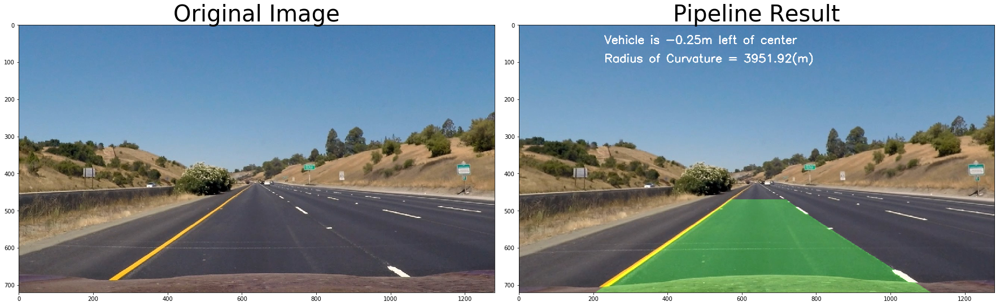

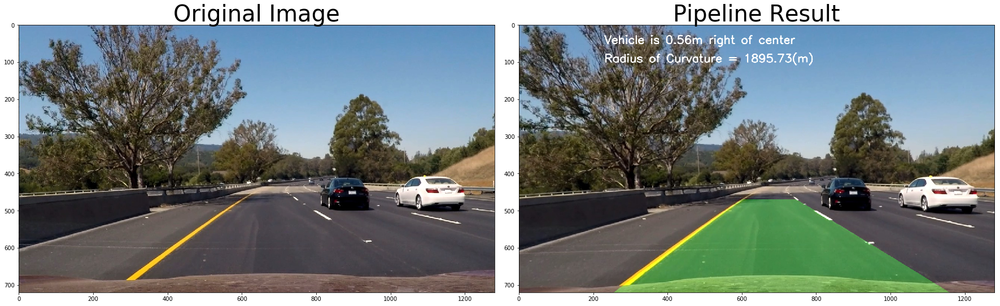

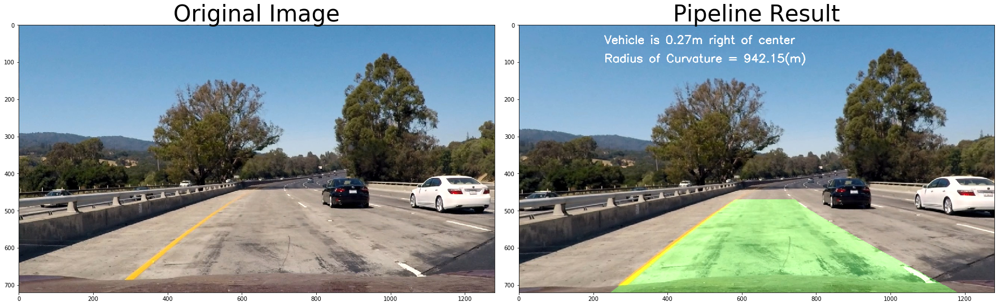

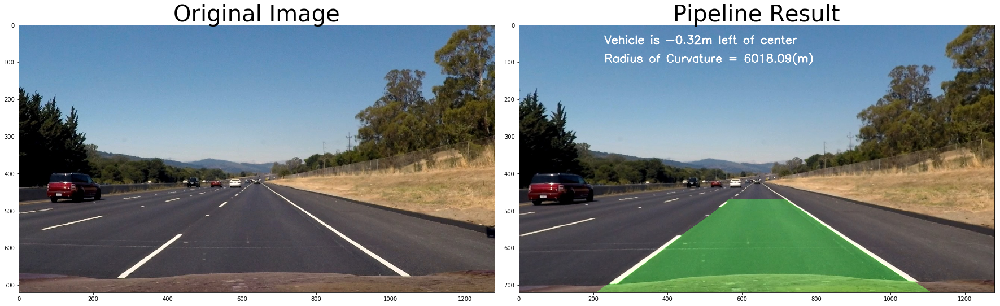

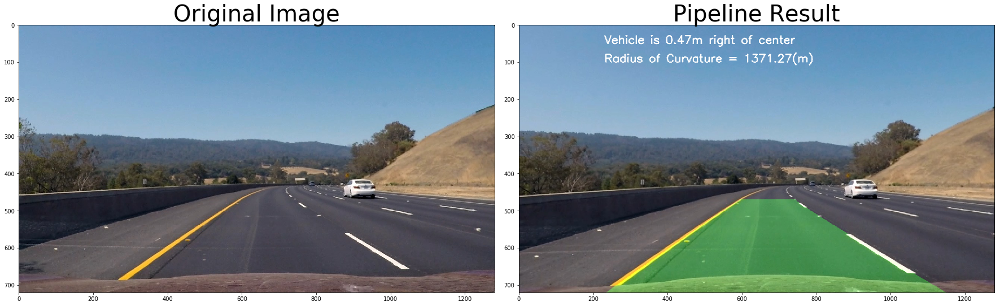

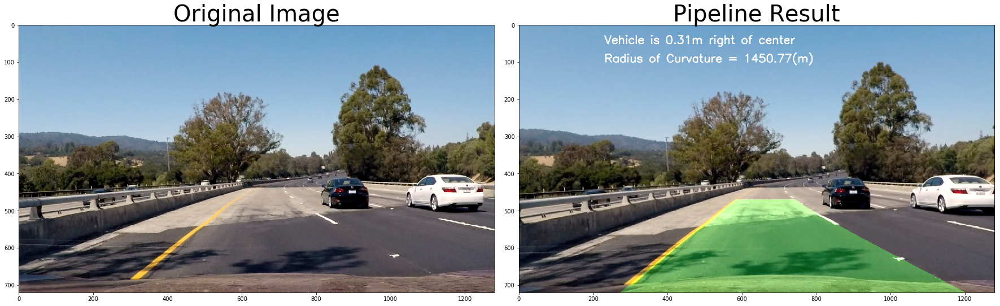

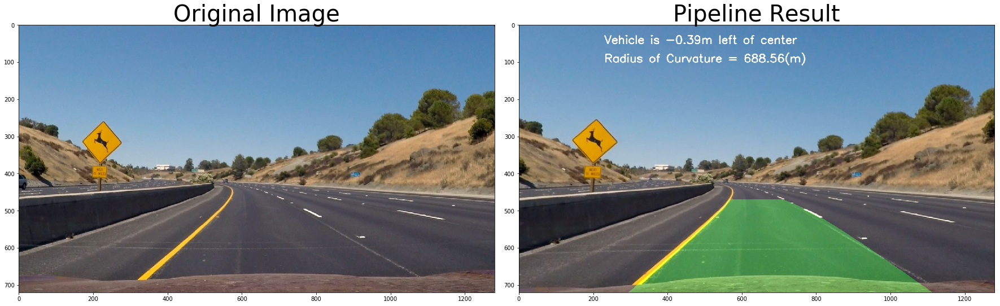

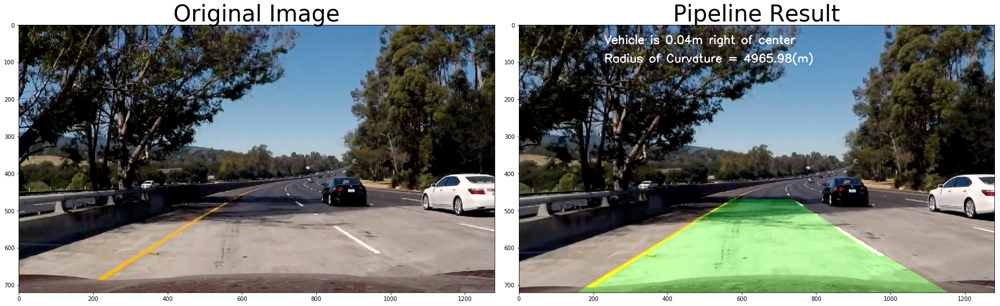

In [7]:
# Gradient and color spaces thresholding
def process_image(img):
    
    undist_img = undistort_image(img, mtx, dist)
    image = np.copy(img)

    # Choose a Sobel kernel size
    ksize = 3 # Choose a larger odd number to smooth gradient measurements

    # Apply each of the thresholding functions
    gradx = abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=(20, 100))
    grady = abs_sobel_thresh(image, orient='y', sobel_kernel=ksize, thresh=(20, 100))
    mag_binary = mag_thresh(image, sobel_kernel=9, mag_thresh=(30, 100))
    dir_binary = dir_threshold(image, sobel_kernel=15, thresh=(0.7, 1.3))
    sxbinary,s_binary = hls_threshold(image)

    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1

    ##B&W binary
    final_combined_binary = np.zeros_like(dir_binary)
    final_combined_binary[(combined == 1) | (sxbinary == 1) | (s_binary == 1)] = 1

    ##color binary
    color_binary = np.dstack((combined, sxbinary, s_binary)) * 255

    warped,M = transform_image(final_combined_binary)

    out_img,left_fit,right_fit = fit_polynomial(warped)
    print(left_fit,right_fit)
    left_curvature, right_curvature, center,curve,ploty,left_fitx,right_fitx=radius_curvature(warped, left_fit, right_fit)
    
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    leftupperpoint  = [570,470]
    rightupperpoint = [720,470]
    leftlowerpoint  = [260,680]
    rightlowerpoint = [1045,680]
    src = np.float32([leftupperpoint, leftlowerpoint, rightupperpoint, rightlowerpoint])
    dst = np.float32([[200,0], [200,680], [1000,0], [1000,680]])

    Minv = cv2.getPerspectiveTransform(dst, src)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    
    result = cv2.addWeighted(undist_img, 1, newwarp, 0.3, 0)
    
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(result, center, (230, 50), font, 1, (255, 255, 255), 2, cv2.LINE_AA)
    cv2.putText(result, curve, (230, 100), font, 1, (255, 255, 255), 2, cv2.LINE_AA)
    
    return result

for fname in glob.glob('test_images/*'):

    img = mpimg.imread(fname)
    result = process_image(img)
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=40)

    ax2.imshow(result)
        # Plots the left and right polynomials on the lane lines
    #ax2.plot(left_fitx, ploty, color='yellow')
    #ax2.plot(right_fitx, ploty, color='yellow')
    ax2.set_title('Pipeline Result', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

    #print(left_curvature, right_curvature, center)


In [8]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [9]:
# Running through the first video

output = 'output_video/challenge_video_out.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
#clip1 = VideoFileClip("./project_video.mp4").subclip(0,5)
clip1 = VideoFileClip("./challenge_video.mp4")
clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time clip.write_videofile(output, audio=False)

[ 3.12615593e-04 -7.08792348e-01  6.20818991e+02] [ 3.71983327e-04 -3.27120081e-01  1.06562881e+03]
[MoviePy] >>>> Building video output_video/challenge_video_out.mp4
[MoviePy] Writing video output_video/challenge_video_out.mp4


  0%|          | 1/485 [00:00<02:40,  3.01it/s]

[ 3.12615593e-04 -7.08792348e-01  6.20818991e+02] [ 3.71983327e-04 -3.27120081e-01  1.06562881e+03]


  0%|          | 2/485 [00:00<02:42,  2.97it/s]

[ 2.86970829e-04 -6.92852964e-01  6.20040109e+02] [ 3.72117401e-04 -3.24369365e-01  1.06420202e+03]


  1%|          | 3/485 [00:01<02:43,  2.94it/s]

[ 3.10201332e-04 -7.15832994e-01  6.26482199e+02] [ 3.57759882e-04 -3.11917339e-01  1.06135169e+03]


  1%|          | 4/485 [00:01<02:46,  2.89it/s]

[ 2.65266316e-04 -6.76657471e-01  6.17848951e+02] [ 3.51488043e-04 -3.12277886e-01  1.06476458e+03]


  1%|          | 5/485 [00:01<02:43,  2.93it/s]

[ 2.59470143e-04 -6.81199416e-01  6.24194100e+02] [ 2.93809795e-04 -2.69115949e-01  1.05734817e+03]


  1%|          | 6/485 [00:02<02:40,  2.98it/s]

[ 2.71892410e-04 -6.93471896e-01  6.28552990e+02] [ 2.72346119e-04 -2.55657261e-01  1.05724626e+03]


  1%|▏         | 7/485 [00:02<02:37,  3.03it/s]

[ 3.03475108e-04 -7.28644059e-01  6.40450605e+02] [ 3.01315828e-04 -2.78447997e-01  1.06049388e+03]


  2%|▏         | 8/485 [00:02<02:37,  3.02it/s]

[ 2.73090345e-04 -7.08260490e-01  6.39050344e+02] [ 2.51366304e-04 -2.41794650e-01  1.05753766e+03]


  2%|▏         | 9/485 [00:03<02:37,  3.02it/s]

[ 2.64333556e-04 -7.02809246e-01  6.41917056e+02] [ 2.17702592e-04 -2.09698610e-01  1.05189697e+03]


  2%|▏         | 10/485 [00:03<02:38,  2.99it/s]

[ 3.39966699e-04 -7.61056950e-01  6.53035643e+02] [ 2.79802863e-04 -2.60155455e-01  1.06223130e+03]


  2%|▏         | 11/485 [00:03<02:38,  2.99it/s]

[ 3.24640257e-04 -7.50011139e-01  6.49673969e+02] [ 2.66163433e-04 -2.57115211e-01  1.06763157e+03]


  2%|▏         | 12/485 [00:04<02:37,  3.01it/s]

[ 3.30938937e-04 -7.44235701e-01  6.43893406e+02] [ 2.51735361e-04 -2.49526831e-01  1.07124818e+03]


  3%|▎         | 13/485 [00:04<02:38,  2.98it/s]

[ 3.56398089e-04 -7.64657373e-01  6.46866489e+02] [ 2.32497135e-04 -2.35010509e-01  1.07154026e+03]


  3%|▎         | 14/485 [00:04<02:36,  3.00it/s]

[ 3.73815740e-04 -7.79587995e-01  6.49684834e+02] [ 2.26604113e-04 -2.38743244e-01  1.07725817e+03]


  3%|▎         | 15/485 [00:05<02:34,  3.04it/s]

[ 3.87779236e-04 -7.85016626e-01  6.47794116e+02] [ 2.76231467e-04 -2.78099792e-01  1.08511241e+03]


  3%|▎         | 16/485 [00:05<02:35,  3.02it/s]

[ 3.86968618e-04 -7.96631878e-01  6.55016392e+02] [ 3.32640289e-04 -3.22753772e-01  1.09319406e+03]


  4%|▎         | 17/485 [00:05<02:35,  3.02it/s]

[ 4.08976008e-04 -8.02476410e-01  6.50590764e+02] [ 2.91659135e-04 -3.00137069e-01  1.09444683e+03]


  4%|▎         | 18/485 [00:06<02:34,  3.03it/s]

[ 4.43921132e-04 -8.49317509e-01  6.67186843e+02] [ 3.61601344e-04 -3.55295843e-01  1.10114986e+03]


  4%|▍         | 19/485 [00:06<02:34,  3.02it/s]

[ 4.31099203e-04 -8.40906946e-01  6.65167766e+02] [ 2.80854503e-04 -2.87898548e-01  1.09162190e+03]


  4%|▍         | 20/485 [00:06<02:33,  3.04it/s]

[ 4.47328228e-04 -8.59430459e-01  6.70317701e+02] [ 2.55456424e-04 -2.60084490e-01  1.08551188e+03]


  4%|▍         | 21/485 [00:06<02:32,  3.04it/s]

[ 4.58280512e-04 -8.58962352e-01  6.65480786e+02] [ 3.29051329e-04 -3.31620627e-01  1.10544689e+03]


  5%|▍         | 22/485 [00:07<02:31,  3.05it/s]

[ 4.74533230e-04 -8.81983589e-01  6.75546549e+02] [ 3.74966670e-04 -3.74869792e-01  1.11401908e+03]


  5%|▍         | 23/485 [00:07<02:31,  3.04it/s]

[ 4.55576173e-04 -8.54136131e-01  6.63831787e+02] [ 4.06466234e-04 -4.09020381e-01  1.12710374e+03]


  5%|▍         | 24/485 [00:07<02:31,  3.04it/s]

[ 3.93587048e-04 -8.35246942e-01  6.76040768e+02] [ 4.45211511e-04 -4.50666636e-01  1.13725876e+03]


  5%|▌         | 25/485 [00:08<02:30,  3.07it/s]

[ 3.94502982e-04 -8.47780363e-01  6.84403747e+02] [ 4.64943520e-04 -4.62931500e-01  1.13866577e+03]


  5%|▌         | 26/485 [00:08<02:30,  3.06it/s]

[ 4.35977270e-04 -8.99884727e-01  7.03846946e+02] [ 4.62703019e-04 -4.56438776e-01  1.13361548e+03]


  6%|▌         | 27/485 [00:08<02:31,  3.03it/s]

[ 5.03402966e-04 -9.44216921e-01  7.04909885e+02] [ 4.22943957e-04 -4.50844084e-01  1.14480364e+03]


  6%|▌         | 28/485 [00:09<02:31,  3.02it/s]

[ 5.46506951e-04 -9.90625935e-01  7.19550145e+02] [ 4.21362097e-04 -4.57850815e-01  1.14741384e+03]


  6%|▌         | 29/485 [00:09<02:31,  3.01it/s]

[ 5.18179104e-04 -9.74223097e-01  7.20576534e+02] [ 4.01995141e-04 -4.49707625e-01  1.14989009e+03]


  6%|▌         | 30/485 [00:09<02:32,  2.98it/s]

[ 5.77915380e-04 -1.01664922e+00  7.25248936e+02] [ 3.59571779e-04 -4.28636329e-01  1.15341508e+03]


  6%|▋         | 31/485 [00:10<02:33,  2.95it/s]

[-6.37575442e-04  2.92690745e-01  3.82259743e+02] [ 3.49148611e-04 -4.27553322e-01  1.15934895e+03]


  7%|▋         | 32/485 [00:10<02:31,  2.99it/s]

[-6.25871420e-04  3.16366442e-01  3.65217220e+02] [ 2.89034189e-04 -3.89319405e-01  1.16250760e+03]


  7%|▋         | 33/485 [00:10<02:29,  3.02it/s]

[-5.42282965e-04  2.82289381e-01  3.56576991e+02] [ 2.77617700e-04 -3.78039888e-01  1.16746743e+03]


  7%|▋         | 34/485 [00:11<02:27,  3.05it/s]

[-4.16867896e-04  1.89189421e-01  3.67243357e+02] [ 3.81148446e-04 -4.36490619e-01  1.17522452e+03]


  7%|▋         | 35/485 [00:11<02:26,  3.07it/s]

[-3.76484729e-04  1.95912209e-01  3.48151493e+02] [ 3.98086050e-04 -4.41674521e-01  1.18187946e+03]


  7%|▋         | 36/485 [00:11<02:23,  3.13it/s]

[-2.10824616e-04  1.08545724e-01  3.41374067e+02] [ 3.94932285e-04 -4.34583437e-01  1.18102147e+03]


  8%|▊         | 37/485 [00:12<02:22,  3.15it/s]

[ 3.20192488e-05 -7.36915622e-02  3.63156109e+02] [ 3.75910695e-04 -4.19422180e-01  1.18019673e+03]


  8%|▊         | 38/485 [00:12<02:22,  3.15it/s]

[ 6.18109800e-05 -8.22900888e-02  3.56694257e+02] [ 3.82993927e-04 -4.26798955e-01  1.18276126e+03]


  8%|▊         | 39/485 [00:12<02:21,  3.15it/s]

[ 1.17966404e-04 -1.23839522e-01  3.60084984e+02] [ 3.50332892e-04 -4.12364500e-01  1.18797798e+03]


  8%|▊         | 40/485 [00:13<02:20,  3.16it/s]

[ 3.09979093e-04 -2.78251571e-01  3.81227538e+02] [ 3.54463565e-04 -4.19238344e-01  1.19468518e+03]


  8%|▊         | 41/485 [00:13<02:21,  3.14it/s]

[ 1.67709561e-04 -1.87883782e-01  3.73577149e+02] [ 2.97546294e-04 -3.87035501e-01  1.20067556e+03]


  9%|▊         | 42/485 [00:13<02:22,  3.11it/s]

[ 3.09468273e-04 -2.71139225e-01  3.67808547e+02] [ 2.66435985e-04 -3.76100517e-01  1.20639640e+03]


  9%|▉         | 43/485 [00:14<02:29,  2.97it/s]

[ 2.12783649e-04 -2.47853628e-01  3.85713791e+02] [ 2.64412802e-04 -3.69407042e-01  1.20570683e+03]


  9%|▉         | 44/485 [00:14<02:25,  3.04it/s]

[ 1.02546410e-04 -2.32843703e-01  3.96780706e+02] [ 2.86128046e-04 -3.84903330e-01  1.21058414e+03]


  9%|▉         | 45/485 [00:14<02:23,  3.06it/s]

[ 7.12983512e-04 -6.38819530e-01  4.35353138e+02] [ 3.02463607e-04 -3.93548689e-01  1.21127392e+03]


  9%|▉         | 46/485 [00:15<02:23,  3.05it/s]

[ 6.18301182e-04 -5.85814219e-01  4.22740712e+02] [ 3.24967530e-04 -4.09585830e-01  1.22314659e+03]


 10%|▉         | 47/485 [00:15<02:22,  3.07it/s]

[ 7.20591505e-04 -6.75425061e-01  4.32802050e+02] [ 3.43417849e-04 -4.24763033e-01  1.23267267e+03]


 10%|▉         | 48/485 [00:15<02:24,  3.02it/s]

[ 9.33512945e-04 -8.41080342e-01  4.47158182e+02] [ 3.09284098e-04 -4.05281042e-01  1.23714403e+03]


 10%|█         | 49/485 [00:16<02:22,  3.06it/s]

[ 4.25924264e-04 -1.07232045e+00  4.96637878e+02] [ 3.26807392e-04 -4.14869190e-01  1.23826150e+03]


 10%|█         | 50/485 [00:16<02:20,  3.10it/s]

[ 1.15086355e-03 -1.04137717e+00  4.86611753e+02] [ 3.42696517e-04 -4.24940895e-01  1.24243363e+03]


 11%|█         | 51/485 [00:16<02:18,  3.13it/s]

[ 1.29669799e-03 -1.17393208e+00  5.12565475e+02] [ 3.75459315e-04 -4.50615599e-01  1.24910011e+03]


 11%|█         | 52/485 [00:17<02:18,  3.14it/s]

[ 1.21531159e-03 -1.13114910e+00  5.15384547e+02] [ 3.76215830e-04 -4.50565297e-01  1.25258193e+03]


 11%|█         | 53/485 [00:17<02:18,  3.13it/s]

[ 1.21762311e-03 -1.14759684e+00  5.27149117e+02] [ 3.78797397e-04 -4.53951957e-01  1.25725262e+03]


 11%|█         | 54/485 [00:17<02:23,  3.00it/s]

[ 1.26409220e-03 -1.13749695e+00  5.08360754e+02] [ 3.47321555e-04 -4.36431200e-01  1.26811915e+03]


 11%|█▏        | 55/485 [00:18<02:24,  2.98it/s]

[ 1.02119856e-03 -9.98178991e-01  5.03123894e+02] [ 3.46264787e-04 -4.36460304e-01  1.27431870e+03]


 12%|█▏        | 56/485 [00:18<02:23,  2.98it/s]

[ 9.91551687e-04 -9.86645963e-01  5.07591877e+02] [ 3.54405431e-04 -4.43616670e-01  1.27972965e+03]


 12%|█▏        | 57/485 [00:18<02:22,  3.00it/s]

[ 1.08071327e-03 -1.07939401e+00  5.27033938e+02] [ 3.72348764e-04 -4.59858443e-01  1.28483437e+03]


 12%|█▏        | 58/485 [00:19<02:20,  3.04it/s]

[ 1.14830598e-03 -1.16170299e+00  5.43345239e+02] [ 4.03986013e-04 -4.78428485e-01  1.28955013e+03]


 12%|█▏        | 59/485 [00:19<02:18,  3.07it/s]

[ 1.21542646e-03 -1.23823841e+00  5.61546802e+02] [ 4.39357981e-04 -5.02275548e-01  1.29557282e+03]


 12%|█▏        | 60/485 [00:19<02:21,  2.99it/s]

[ 1.19688605e-03 -1.23846425e+00  5.57390654e+02] [ 3.04243080e-04 -4.21202747e-01  1.29352386e+03]


 13%|█▎        | 61/485 [00:20<02:23,  2.95it/s]

[ 1.12619669e-03 -1.13906531e+00  5.40955197e+02] [ 2.62804238e-04 -3.85041308e-01  1.29512142e+03]


 13%|█▎        | 62/485 [00:20<02:26,  2.88it/s]

[ 1.08930574e-03 -1.11497581e+00  5.30526547e+02] [ 1.76834647e-04 -3.19917762e-01  1.29396002e+03]


 13%|█▎        | 63/485 [00:20<02:25,  2.91it/s]

[ 1.08032863e-03 -1.12587728e+00  5.39524624e+02] [ 2.23851125e-04 -3.40112240e-01  1.29772868e+03]


 13%|█▎        | 64/485 [00:21<02:22,  2.96it/s]

[ 1.03795587e-03 -1.10574787e+00  5.46835982e+02] [ 2.97911097e-04 -3.98196364e-01  1.30927286e+03]


 13%|█▎        | 65/485 [00:21<02:18,  3.03it/s]

[ 1.01721334e-03 -1.12068910e+00  5.53904837e+02] [ 2.90126033e-04 -3.90665837e-01  1.31110541e+03]


 14%|█▎        | 66/485 [00:21<02:16,  3.07it/s]

[ 1.02493181e-03 -1.15272954e+00  5.67509010e+02] [ 3.49263188e-04 -4.24942250e-01  1.31570979e+03]


 14%|█▍        | 67/485 [00:22<02:16,  3.06it/s]

[ 1.02361508e-03 -1.16760262e+00  5.80265546e+02] [ 3.59953832e-04 -4.30521649e-01  1.31631524e+03]


 14%|█▍        | 68/485 [00:22<02:18,  3.01it/s]

[ 1.02067547e-03 -1.16684484e+00  5.82335055e+02] [ 3.28809282e-04 -4.16456059e-01  1.32247541e+03]


 14%|█▍        | 69/485 [00:22<02:16,  3.05it/s]

[ 9.57318547e-04 -1.17005907e+00  5.99406604e+02] [ 2.98857857e-04 -3.85121857e-01  1.31678441e+03]


 14%|█▍        | 70/485 [00:23<02:14,  3.08it/s]

[ 9.47526347e-04 -1.15597992e+00  5.95450025e+02] [ 3.11079695e-04 -3.95697934e-01  1.32725393e+03]


 15%|█▍        | 71/485 [00:23<02:12,  3.13it/s]

[ 9.27296075e-04 -1.13704771e+00  5.95543170e+02] [ 2.91703466e-04 -3.68285973e-01  1.32683695e+03]


 15%|█▍        | 72/485 [00:23<02:14,  3.06it/s]

[ 8.97554188e-04 -1.09534266e+00  5.81587520e+02] [ 1.84885942e-04 -2.73446716e-01  1.31788503e+03]


 15%|█▌        | 73/485 [00:24<02:13,  3.08it/s]

[ 8.84429554e-04 -1.09880801e+00  5.84623887e+02] [ 1.36357797e-04 -2.10298986e-01  1.30169264e+03]


 15%|█▌        | 74/485 [00:24<02:11,  3.13it/s]

[ 8.57073234e-04 -1.06249614e+00  5.71642137e+02] [-5.66233207e-05 -1.39259785e-02  1.26224372e+03]


 15%|█▌        | 75/485 [00:24<02:11,  3.11it/s]

[ 8.54125454e-04 -1.05771354e+00  5.72098638e+02] [ 2.33378205e-07 -5.89004720e-02  1.27332521e+03]


 16%|█▌        | 76/485 [00:25<02:12,  3.09it/s]

[ 8.54155402e-04 -1.05982441e+00  5.74028061e+02] [ 7.60352232e-05 -1.15074913e-01  1.28369892e+03]


 16%|█▌        | 77/485 [00:25<02:10,  3.12it/s]

[ 8.32712537e-04 -1.04488592e+00  5.71967722e+02] [ 1.91278730e-04 -2.13083638e-01  1.30387234e+03]


 16%|█▌        | 78/485 [00:25<02:10,  3.11it/s]

[ 7.88885056e-04 -1.02558600e+00  5.72144466e+02] [ 3.27822392e-04 -3.39060564e-01  1.33238422e+03]


 16%|█▋        | 79/485 [00:25<02:11,  3.09it/s]

[ 7.54269492e-04 -1.01455392e+00  5.77984928e+02] [ 5.50639729e-04 -5.58950789e-01  1.38568994e+03]


 16%|█▋        | 80/485 [00:26<02:12,  3.06it/s]

[ 7.53595626e-04 -1.02565242e+00  5.82217791e+02] [ 8.01660009e-04 -8.14733262e-01  1.44876226e+03]


 17%|█▋        | 81/485 [00:26<02:10,  3.10it/s]

[ 7.16181794e-04 -1.01393500e+00  5.87605044e+02] [ 8.35929215e-04 -8.55185081e-01  1.46031545e+03]


 17%|█▋        | 82/485 [00:26<02:09,  3.11it/s]

[ 6.65456118e-04 -9.50720521e-01  5.61390109e+02] [ 1.29585250e-03 -1.35575086e+00  1.59650073e+03]


 17%|█▋        | 83/485 [00:27<02:08,  3.12it/s]

[ 6.21096676e-04 -9.26689787e-01  5.52071130e+02] [ 1.80916429e-03 -1.92302058e+00  1.75153030e+03]


 17%|█▋        | 84/485 [00:27<02:10,  3.07it/s]

[ 5.77081463e-04 -8.97269680e-01  5.46793131e+02] [ 2.21530862e-03 -2.41810507e+00  1.89722797e+03]


 18%|█▊        | 85/485 [00:27<02:10,  3.07it/s]

[ 4.89244834e-04 -8.59614640e-01  5.47328296e+02] [ 1.40440667e-03 -1.61416755e+00  1.70529092e+03]


 18%|█▊        | 86/485 [00:28<02:09,  3.08it/s]

[ 4.73313906e-04 -8.44519328e-01  5.46736143e+02] [ 5.41335190e-04 -7.84836663e-01  1.51475681e+03]


 18%|█▊        | 87/485 [00:28<02:10,  3.04it/s]

[ 4.36543490e-04 -8.46759545e-01  5.60586404e+02] [-7.72943358e-04  6.17997524e-01  1.14935304e+03]


 18%|█▊        | 88/485 [00:28<02:15,  2.94it/s]

[ 4.18388309e-04 -8.38907767e-01  5.66771562e+02] [-1.58198842e-03  1.54849826e+00  8.89892207e+02]


 18%|█▊        | 89/485 [00:29<02:15,  2.92it/s]

[ 4.14616478e-04 -8.32239354e-01  5.66436385e+02] [-1.87166695e-03  1.94734019e+00  7.64059111e+02]


 19%|█▊        | 90/485 [00:29<02:13,  2.96it/s]

[ 5.42394914e-04 -8.56862577e-01  5.54378489e+02] [-1.70493903e-03  1.81936635e+00  7.90884929e+02]


 19%|█▉        | 91/485 [00:29<02:11,  3.00it/s]

[ 4.98575060e-04 -8.48474632e-01  5.57375070e+02] [-1.12021208e-03  1.24131187e+00  9.30289701e+02]


 19%|█▉        | 92/485 [00:30<02:12,  2.97it/s]

[ 4.52229395e-04 -8.19791574e-01  5.53884925e+02] [-1.08871417e-03  1.25681719e+00  9.11873595e+02]


 19%|█▉        | 93/485 [00:30<02:25,  2.70it/s]

[ 4.68300902e-04 -8.08886018e-01  5.44301711e+02] [ 2.14562224e-04 -1.82918746e-01  1.30737000e+03]


 19%|█▉        | 94/485 [00:31<02:19,  2.79it/s]

[ 4.70030695e-04 -7.91116268e-01  5.33060446e+02] [ 6.83052405e-04 -7.42062174e-01  1.16971673e+03]


 20%|█▉        | 95/485 [00:31<02:22,  2.73it/s]

[ 4.49249271e-04 -8.02571439e-01  5.46077616e+02] [ 4.98881225e-04 -6.10484403e-01  1.14642395e+03]


 20%|█▉        | 96/485 [00:31<02:21,  2.76it/s]

[ 5.59752933e-04 -8.59222472e-01  5.57063043e+02] [ 4.33419615e-04 -5.60692561e-01  1.13554639e+03]


 20%|██        | 97/485 [00:32<02:15,  2.87it/s]

[ 6.55995426e-04 -9.60199298e-01  5.96336937e+02] [ 5.00126993e-04 -5.97700019e-01  1.13068307e+03]


 20%|██        | 98/485 [00:32<02:11,  2.95it/s]

[ 7.22207147e-04 -1.01234476e+00  6.10591557e+02] [ 4.63147665e-04 -5.76035375e-01  1.12552766e+03]


 20%|██        | 99/485 [00:32<02:18,  2.78it/s]

[ 8.36616040e-04 -1.11825876e+00  6.38440349e+02] [ 4.55262308e-04 -5.70517858e-01  1.12057160e+03]


 21%|██        | 100/485 [00:33<02:20,  2.73it/s]

[ 8.66223289e-04 -1.12616773e+00  6.32286553e+02] [ 4.13702844e-04 -5.41007148e-01  1.11838225e+03]


 21%|██        | 101/485 [00:33<02:14,  2.85it/s]

[ 8.76858704e-04 -1.09423552e+00  6.08220247e+02] [ 3.90163224e-04 -5.25500104e-01  1.12138329e+03]


 21%|██        | 102/485 [00:33<02:12,  2.90it/s]

[ 8.96283834e-04 -1.08580074e+00  5.91447390e+02] [ 3.63771631e-04 -5.02681527e-01  1.12112141e+03]


 21%|██        | 103/485 [00:34<02:11,  2.90it/s]

[ 9.04003809e-04 -1.08270575e+00  5.83712016e+02] [ 3.66270939e-04 -5.01803019e-01  1.12236220e+03]


 21%|██▏       | 104/485 [00:34<02:09,  2.95it/s]

[ 9.19043110e-04 -1.05423517e+00  5.57774469e+02] [ 3.89719960e-04 -5.05175338e-01  1.12524415e+03]


 22%|██▏       | 105/485 [00:34<02:06,  3.00it/s]

[ 8.48236662e-04 -1.03427185e+00  5.53728916e+02] [ 4.52805836e-04 -5.26833502e-01  1.12399004e+03]


 22%|██▏       | 106/485 [00:35<02:05,  3.02it/s]

[ 7.91778608e-04 -1.01853520e+00  5.51660740e+02] [ 5.65554005e-04 -5.85594495e-01  1.12811423e+03]


 22%|██▏       | 107/485 [00:35<02:06,  2.99it/s]

[ 8.00764353e-04 -1.01197205e+00  5.49541228e+02] [ 7.05404393e-04 -6.61595945e-01  1.13298362e+03]


 22%|██▏       | 108/485 [00:35<02:07,  2.95it/s]

[ 9.29228623e-04 -1.14743753e+00  5.81101105e+02] [ 4.74275082e-04 -5.40723058e-01  1.11863040e+03]


 22%|██▏       | 109/485 [00:36<02:35,  2.41it/s]

[ 1.03944974e-03 -1.19833538e+00  5.96825436e+02] [ 5.22949650e-04 -5.73213010e-01  1.11737283e+03]


 23%|██▎       | 110/485 [00:36<02:30,  2.50it/s]

[ 1.24640153e-03 -1.35578793e+00  6.31126449e+02] [ 8.76511687e-04 -8.23722137e-01  1.15148221e+03]


 23%|██▎       | 111/485 [00:37<02:33,  2.44it/s]

[ 1.38715690e-03 -1.48489641e+00  6.65158260e+02] [ 8.41785434e-04 -8.17230755e-01  1.15217914e+03]


 23%|██▎       | 112/485 [00:37<02:27,  2.53it/s]

[ 1.32394671e-03 -1.43578989e+00  6.55551582e+02] [ 8.27145564e-04 -8.23445721e-01  1.15793340e+03]


 23%|██▎       | 113/485 [00:37<02:15,  2.74it/s]

[ 1.36600535e-03 -1.52787939e+00  6.96256811e+02] [ 8.54954447e-04 -8.61863191e-01  1.16501197e+03]


 24%|██▎       | 114/485 [00:38<02:12,  2.79it/s]

[ 1.35036760e-03 -1.50469379e+00  6.88598746e+02] [ 6.52743781e-04 -7.07209526e-01  1.14630006e+03]


 24%|██▎       | 115/485 [00:38<02:14,  2.76it/s]

[ 1.46777078e-03 -1.62826610e+00  7.20379970e+02] [ 5.47066947e-04 -6.25324923e-01  1.13577915e+03]


 24%|██▍       | 116/485 [00:39<02:16,  2.70it/s]

[ 1.42121872e-03 -1.57988982e+00  7.06629269e+02] [ 5.42652326e-04 -6.25597664e-01  1.14218694e+03]


 24%|██▍       | 117/485 [00:39<02:12,  2.79it/s]

[ 1.39927492e-03 -1.58942975e+00  7.19370357e+02] [ 4.98325201e-04 -5.85446526e-01  1.13278193e+03]


 24%|██▍       | 118/485 [00:39<02:26,  2.51it/s]

[ 1.89824576e-03 -2.10957176e+00  8.61666694e+02] [ 6.16875186e-04 -6.89113011e-01  1.15399380e+03]


 25%|██▍       | 119/485 [00:40<02:23,  2.56it/s]

[ 1.77440426e-03 -2.04383038e+00  8.66071950e+02] [ 9.64924690e-04 -9.81690463e-01  1.21043596e+03]


 25%|██▍       | 120/485 [00:40<02:16,  2.67it/s]

[ 1.75657451e-03 -2.14159023e+00  9.24221048e+02] [ 1.54849688e-03 -1.51755469e+00  1.32961608e+03]


 25%|██▍       | 121/485 [00:40<02:18,  2.63it/s]

[ 2.05020440e-03 -2.50038059e+00  1.03575156e+03] [ 8.15406161e-04 -8.85376122e-01  1.19389940e+03]


 25%|██▌       | 122/485 [00:41<02:30,  2.41it/s]

[ 2.13330674e-03 -2.61263966e+00  1.07316384e+03] [ 7.28559835e-04 -8.00542754e-01  1.17497586e+03]


 25%|██▌       | 123/485 [00:41<02:42,  2.23it/s]

[ 1.96100148e-03 -2.47043792e+00  1.05026092e+03] [ 3.95911023e-04 -4.76656389e-01  1.09576691e+03]


 26%|██▌       | 124/485 [00:42<02:52,  2.09it/s]

[ 2.20902949e-03 -2.81320392e+00  1.16508542e+03] [ 2.79634104e-04 -3.21054596e-01  1.04874808e+03]


 26%|██▌       | 125/485 [00:42<02:49,  2.13it/s]

[ 2.44835033e-03 -3.15032796e+00  1.28285535e+03] [ 4.26490728e-04 -4.02888962e-01  1.04828289e+03]


 26%|██▌       | 126/485 [00:43<02:45,  2.17it/s]

[ 9.36151139e-04 -1.44044404e+00  8.02777446e+02] [ 1.88216683e-04 -2.70691953e-01  1.04917676e+03]


 26%|██▌       | 127/485 [00:43<02:49,  2.11it/s]

[ 8.72879279e-04 -1.43931519e+00  8.29972742e+02] [ 2.14476981e-04 -2.85246459e-01  1.05039282e+03]


 26%|██▋       | 128/485 [00:44<02:53,  2.05it/s]

[-1.86409258e-03  1.80144707e+00 -1.22131832e+02] [ 2.47016976e-04 -3.13442624e-01  1.05672854e+03]


 27%|██▋       | 129/485 [00:44<02:48,  2.11it/s]

[ 1.77238289e-04 -4.12737821e-01  8.07646540e+02] [ 2.27289347e-04 -3.05111738e-01  1.05988471e+03]


 27%|██▋       | 130/485 [00:45<02:52,  2.06it/s]

[ 1.66965291e-04 -4.09086181e-01  8.09192626e+02] [ 3.13760853e-04 -3.71994835e-01  1.06901626e+03]


 27%|██▋       | 131/485 [00:45<02:55,  2.01it/s]

[ 1.57620753e-04 -4.03654807e-01  8.09486413e+02] [ 3.34172701e-04 -3.85014651e-01  1.06921526e+03]


 27%|██▋       | 132/485 [00:46<02:52,  2.04it/s]

[ 1.27563660e-04 -2.50946755e-01  3.78285491e+02] [ 3.60021834e-04 -3.93699344e-01  1.06860198e+03]


 27%|██▋       | 133/485 [00:46<02:58,  1.97it/s]

[-2.88392249e-03  2.74080568e+00 -2.89888535e+02] [ 2.94581410e-04 -4.45760033e-01  8.11774801e+02]


 28%|██▊       | 134/485 [00:47<02:53,  2.02it/s]

[ 3.42888388e-04 -4.64614962e-01  8.10331802e+02] [ 4.72544601e-04 -5.19638712e-01  8.13973212e+02]


 28%|██▊       | 135/485 [00:47<02:43,  2.14it/s]

[ 3.79114500e-04 -4.84111519e-01  8.11922472e+02] [ 5.16749913e-04 -5.45135515e-01  8.16372619e+02]


 28%|██▊       | 136/485 [00:48<02:38,  2.20it/s]

[ 1.95263974e-04 -3.92931493e-01  8.02375007e+02] [ 3.05949841e-04 -4.42218428e-01  8.05932339e+02]


 28%|██▊       | 137/485 [00:48<02:22,  2.44it/s]

[ 3.23366899e-02 -4.18285017e+01  1.35478488e+04] [ 2.17935857e-04 -4.04626581e-01  8.02202383e+02]


 28%|██▊       | 138/485 [00:48<02:10,  2.65it/s]

[-1.94567137e-02  2.65015175e+01 -8.97390757e+03] [ 1.14663270e-04 -3.58075391e-01  7.99411522e+02]


 29%|██▊       | 139/485 [00:49<02:01,  2.85it/s]

[ 1.64232089e-03 -1.54184945e+00  3.47998522e+02] [ 1.37524426e-04 -3.68978270e-01  7.99578620e+02]


 29%|██▉       | 140/485 [00:49<02:05,  2.75it/s]

[ 1.87378410e-04 -3.92751665e-01  8.01016324e+02] [ 2.03213620e-04 -4.00214279e-01  8.01583518e+02]


 29%|██▉       | 141/485 [00:49<02:00,  2.86it/s]

[ 2.06370196e-04 -4.13700129e-01  8.05318414e+02] [ 5.21401121e-04 -4.49337354e-01  1.06411890e+03]


 29%|██▉       | 142/485 [00:50<01:58,  2.90it/s]

[ 2.40011302e-04 -4.44914207e-01  8.10945626e+02] [ 5.26151385e-04 -4.61011193e-01  1.06381009e+03]


 29%|██▉       | 143/485 [00:50<01:52,  3.05it/s]

[ 2.65614895e-04 -4.62272967e-01  8.14757782e+02] [ 5.11381869e-04 -4.73248614e-01  1.06498634e+03]


 30%|██▉       | 144/485 [00:50<01:58,  2.88it/s]

[ 1.06856648e-03 -8.67791281e-01  4.87494345e+02] [ 3.01909878e-04 -4.74027906e-01  8.14338569e+02]


 30%|██▉       | 145/485 [00:51<01:51,  3.04it/s]

[ 1.00714243e-03 -8.39363622e-01  4.86122688e+02] [ 3.79514598e-04 -4.29164945e-01  1.06815481e+03]


 30%|███       | 146/485 [00:51<01:47,  3.15it/s]

[ 9.45520249e-04 -7.66175676e-01  4.51692208e+02] [ 3.04765750e-04 -3.87332290e-01  1.07392411e+03]


 30%|███       | 147/485 [00:51<01:46,  3.18it/s]

[ 1.01572962e-03 -8.11466917e-01  4.51472152e+02] [ 3.02166431e-04 -3.86462592e-01  1.07709956e+03]


 31%|███       | 148/485 [00:52<01:42,  3.27it/s]

[ 9.55364845e-04 -7.73613743e-01  4.49800918e+02] [ 2.83800020e-04 -4.56346612e-01  8.07334659e+02]


 31%|███       | 149/485 [00:52<01:40,  3.33it/s]

[ 9.27385701e-04 -7.56195271e-01  4.51532703e+02] [ 3.38213655e-04 -4.13283077e-01  1.07789634e+03]


 31%|███       | 150/485 [00:52<01:41,  3.32it/s]

[ 1.07821106e-03 -7.84576677e-01  4.52866871e+02] [ 3.11673122e-04 -3.94717512e-01  1.07518311e+03]


 31%|███       | 151/485 [00:53<01:53,  2.95it/s]

[ 1.10403727e-03 -8.16136898e-01  4.70389532e+02] [ 3.00794118e-04 -3.82975147e-01  1.06868565e+03]


 31%|███▏      | 152/485 [00:53<01:47,  3.09it/s]

[ 1.11306839e-03 -8.62854824e-01  4.82182400e+02] [ 2.80726225e-04 -3.58604111e-01  1.06162058e+03]


 32%|███▏      | 153/485 [00:53<01:44,  3.18it/s]

[ 1.00447444e-03 -8.52980080e-01  4.87869838e+02] [ 2.79854300e-04 -3.62349808e-01  1.06116382e+03]


 32%|███▏      | 154/485 [00:54<01:51,  2.97it/s]

[ 1.01513657e-03 -8.29744814e-01  4.79724355e+02] [ 2.62184522e-04 -3.49165075e-01  1.06164775e+03]


 32%|███▏      | 155/485 [00:54<01:46,  3.09it/s]

[ 5.50042382e-04 -7.08490928e-01  4.68784165e+02] [ 2.54501929e-04 -3.48096243e-01  1.06484380e+03]


 32%|███▏      | 156/485 [00:54<01:43,  3.19it/s]

[ 9.01228316e-04 -7.90971196e-01  4.72877735e+02] [ 2.65069401e-04 -3.58760899e-01  1.06740581e+03]


 32%|███▏      | 157/485 [00:54<01:40,  3.26it/s]

[ 8.18719546e-04 -7.48827063e-01  4.66539768e+02] [ 2.69170597e-04 -3.60302471e-01  1.07018418e+03]


 33%|███▎      | 158/485 [00:55<01:45,  3.10it/s]

[ 7.81528359e-04 -7.52721496e-01  4.74945954e+02] [ 3.07830524e-04 -3.79273654e-01  1.06781756e+03]


 33%|███▎      | 159/485 [00:55<01:52,  2.91it/s]

[ 7.52768474e-04 -7.44884708e-01  4.71695980e+02] [ 3.59688077e-04 -4.07093479e-01  1.07260569e+03]


 33%|███▎      | 160/485 [00:55<01:51,  2.92it/s]

[ 6.99304151e-04 -7.28430930e-01  4.73529046e+02] [ 3.69787662e-04 -4.16332001e-01  1.07335913e+03]


 33%|███▎      | 161/485 [00:56<01:47,  3.02it/s]

[ 6.34613005e-04 -6.98433263e-01  4.67589296e+02] [ 5.84149135e-04 -5.26674776e-01  1.08373816e+03]


 33%|███▎      | 162/485 [00:56<01:43,  3.12it/s]

[ 6.26871058e-04 -7.04446223e-01  4.71287281e+02] [ 6.43304215e-04 -5.71590322e-01  1.08802208e+03]


 34%|███▎      | 163/485 [00:56<01:40,  3.20it/s]

[ 5.79693637e-04 -6.76105427e-01  4.69069347e+02] [ 7.48260891e-04 -6.53736847e-01  1.09889976e+03]


 34%|███▍      | 164/485 [00:57<01:45,  3.05it/s]

[ 5.77089937e-04 -6.66908840e-01  4.62458671e+02] [ 6.03480616e-04 -5.75750862e-01  1.09353365e+03]


 34%|███▍      | 165/485 [00:57<01:41,  3.15it/s]

[ 5.53466983e-04 -6.61582041e-01  4.64879272e+02] [ 4.10115367e-04 -4.44473244e-01  1.07351234e+03]


 34%|███▍      | 166/485 [00:57<01:51,  2.86it/s]

[ 5.20568513e-04 -6.45406983e-01  4.65526829e+02] [ 3.72426758e-04 -4.09000722e-01  1.06387527e+03]


 34%|███▍      | 167/485 [00:58<01:52,  2.83it/s]

[ 4.49885119e-04 -6.09995249e-01  4.60637538e+02] [ 2.87033735e-04 -3.60989717e-01  1.05969979e+03]


 35%|███▍      | 168/485 [00:58<01:46,  2.99it/s]

[ 4.66127623e-04 -6.23663086e-01  4.64122375e+02] [ 2.19158787e-04 -3.00643695e-01  1.04622882e+03]


 35%|███▍      | 169/485 [00:58<01:42,  3.09it/s]

[ 4.94833492e-04 -6.27351693e-01  4.67951632e+02] [ 3.33023005e-04 -3.89644684e-01  1.05879780e+03]


 35%|███▌      | 170/485 [00:59<01:40,  3.15it/s]

[ 5.28395558e-04 -6.70317963e-01  4.85454787e+02] [ 3.50752951e-04 -3.95394332e-01  1.05292530e+03]


 35%|███▌      | 171/485 [00:59<01:38,  3.19it/s]

[ 5.36554719e-04 -6.78885256e-01  4.87089954e+02] [ 3.51047367e-04 -3.96769609e-01  1.05360989e+03]


 35%|███▌      | 172/485 [00:59<01:36,  3.24it/s]

[ 5.69742690e-04 -6.82018299e-01  4.78169780e+02] [ 3.35965126e-04 -3.91740195e-01  1.05744461e+03]


 36%|███▌      | 173/485 [01:00<01:45,  2.97it/s]

[ 6.27436128e-04 -7.20536508e-01  4.84740450e+02] [ 3.79618911e-04 -4.22880304e-01  1.06226271e+03]


 36%|███▌      | 174/485 [01:00<02:06,  2.46it/s]

[ 6.07498654e-04 -7.08026204e-01  4.77169803e+02] [ 3.59461703e-04 -4.14643739e-01  1.06313995e+03]


 36%|███▌      | 175/485 [01:01<02:00,  2.58it/s]

[ 5.81521907e-04 -7.12331149e-01  4.76503618e+02] [ 6.20794327e-04 -5.62175977e-01  1.07842778e+03]


 36%|███▋      | 176/485 [01:01<02:09,  2.39it/s]

[ 5.84182975e-04 -7.09426634e-01  4.71417324e+02] [ 4.76104378e-04 -4.87499448e-01  1.07283370e+03]


 36%|███▋      | 177/485 [01:01<02:01,  2.54it/s]

[ 4.77700414e-04 -6.40011179e-01  4.56164270e+02] [ 4.64699973e-04 -4.88882099e-01  1.07765621e+03]


 37%|███▋      | 178/485 [01:02<01:55,  2.65it/s]

[ 6.11134799e-04 -7.34370214e-01  4.77140730e+02] [ 2.00217513e-04 -3.10981523e-01  1.05063097e+03]


 37%|███▋      | 179/485 [01:02<01:51,  2.75it/s]

[ 6.16338475e-04 -7.52609041e-01  4.76843634e+02] [ 2.25772169e-04 -3.21104607e-01  1.05078019e+03]


 37%|███▋      | 180/485 [01:02<01:47,  2.84it/s]

[ 5.54568857e-04 -7.10649492e-01  4.71349802e+02] [ 2.26808807e-04 -3.16583009e-01  1.04901938e+03]


 37%|███▋      | 181/485 [01:03<01:46,  2.87it/s]

[ 5.79254331e-04 -7.04444179e-01  4.60963072e+02] [ 1.89123547e-04 -2.93613273e-01  1.05122213e+03]


 38%|███▊      | 182/485 [01:03<01:46,  2.84it/s]

[ 6.37305617e-04 -7.66722963e-01  4.80509360e+02] [ 2.29978424e-04 -3.14335317e-01  1.04818883e+03]


 38%|███▊      | 183/485 [01:03<01:43,  2.92it/s]

[ 6.57926623e-04 -7.90768973e-01  4.86332634e+02] [ 2.40630109e-04 -3.21049704e-01  1.04729287e+03]


 38%|███▊      | 184/485 [01:04<01:41,  2.97it/s]

[ 5.60223009e-04 -7.26093924e-01  4.71629845e+02] [ 2.27833072e-04 -3.09353189e-01  1.04951431e+03]


 38%|███▊      | 185/485 [01:04<01:41,  2.94it/s]

[ 5.62360880e-04 -7.35789423e-01  4.77383472e+02] [ 2.59835240e-04 -3.29531400e-01  1.05118631e+03]


 38%|███▊      | 186/485 [01:04<01:39,  2.99it/s]

[ 5.74639134e-04 -7.53252876e-01  4.80775321e+02] [ 2.49844095e-04 -3.22821925e-01  1.05016060e+03]


 39%|███▊      | 187/485 [01:05<01:38,  3.04it/s]

[ 7.27291968e-04 -8.08532658e-01  4.88760292e+02] [ 2.46396564e-04 -3.15939310e-01  1.04701874e+03]


 39%|███▉      | 188/485 [01:05<01:38,  3.02it/s]

[ 5.89567198e-04 -7.74012652e-01  4.93087436e+02] [ 2.98630523e-04 -3.42207751e-01  1.04795862e+03]


 39%|███▉      | 189/485 [01:05<01:38,  3.00it/s]

[ 6.44928198e-04 -8.03537026e-01  5.01693273e+02] [ 2.91189792e-04 -3.34934935e-01  1.04466426e+03]


 39%|███▉      | 190/485 [01:06<01:37,  3.04it/s]

[ 7.07045026e-04 -8.30469760e-01  5.08882275e+02] [ 2.79646235e-04 -3.28749148e-01  1.04177456e+03]


 39%|███▉      | 191/485 [01:06<01:37,  3.01it/s]

[ 7.11347661e-04 -8.26194411e-01  5.02288209e+02] [ 2.77958750e-04 -3.26952628e-01  1.04327602e+03]


 40%|███▉      | 192/485 [01:06<01:40,  2.92it/s]

[ 7.27647694e-04 -8.20493754e-01  4.96339750e+02] [ 3.00688108e-04 -3.45001021e-01  1.04778107e+03]


 40%|███▉      | 193/485 [01:07<01:38,  2.97it/s]

[ 7.46010110e-04 -8.43942937e-01  5.03612886e+02] [ 2.98033462e-04 -3.45928549e-01  1.04630783e+03]


 40%|████      | 194/485 [01:07<01:37,  2.99it/s]

[ 7.25899949e-04 -8.51172181e-01  5.13997653e+02] [ 3.28799604e-04 -3.65557333e-01  1.04593469e+03]


 40%|████      | 195/485 [01:07<01:36,  3.02it/s]

[ 7.34443214e-04 -8.73859569e-01  5.24828096e+02] [ 3.26318975e-04 -3.62139645e-01  1.04231879e+03]


 40%|████      | 196/485 [01:08<01:40,  2.89it/s]

[ 7.37392411e-04 -8.82495955e-01  5.31456365e+02] [ 3.62347073e-04 -3.87649884e-01  1.04465585e+03]


 41%|████      | 197/485 [01:08<01:41,  2.83it/s]

[ 7.27329563e-04 -8.71618565e-01  5.33477339e+02] [ 3.36647150e-04 -3.65964360e-01  1.04132172e+03]


 41%|████      | 198/485 [01:09<01:41,  2.83it/s]

[ 7.04868589e-04 -8.45881317e-01  5.25164062e+02] [ 3.36952810e-04 -3.70898767e-01  1.04527268e+03]


 41%|████      | 199/485 [01:09<01:45,  2.70it/s]

[ 7.01086483e-04 -8.31903973e-01  5.19138136e+02] [ 3.42185108e-04 -3.76190078e-01  1.04786293e+03]


 41%|████      | 200/485 [01:09<01:41,  2.81it/s]

[ 7.16456883e-04 -8.41991454e-01  5.21256863e+02] [ 3.65893859e-04 -3.85221236e-01  1.04864115e+03]


 41%|████▏     | 201/485 [01:10<01:39,  2.84it/s]

[ 6.82371442e-04 -8.17729263e-01  5.17565048e+02] [ 4.08854336e-04 -4.14108709e-01  1.05257589e+03]


 42%|████▏     | 202/485 [01:10<01:37,  2.90it/s]

[ 6.67469828e-04 -8.25155544e-01  5.21435280e+02] [ 3.08906538e-04 -3.57727362e-01  1.04633318e+03]


 42%|████▏     | 203/485 [01:10<01:34,  3.00it/s]

[ 6.81238001e-04 -8.43672704e-01  5.28359765e+02] [ 3.09984699e-04 -3.65046819e-01  1.04653317e+03]


 42%|████▏     | 204/485 [01:11<01:32,  3.05it/s]

[ 6.91443673e-04 -8.56399100e-01  5.34173387e+02] [ 3.10264393e-04 -3.67969537e-01  1.04568351e+03]


 42%|████▏     | 205/485 [01:11<01:31,  3.07it/s]

[ 6.80182406e-04 -8.59619419e-01  5.41417605e+02] [ 3.26922585e-04 -3.84677276e-01  1.04661928e+03]


 42%|████▏     | 206/485 [01:11<01:33,  3.00it/s]

[ 7.04717207e-04 -8.82285274e-01  5.44308250e+02] [ 3.93596184e-04 -4.21255549e-01  1.04891167e+03]


 43%|████▎     | 207/485 [01:12<01:32,  3.01it/s]

[ 6.82739134e-04 -8.65046036e-01  5.41427993e+02] [ 3.63726204e-04 -4.05825418e-01  1.04816369e+03]


 43%|████▎     | 208/485 [01:12<01:30,  3.06it/s]

[ 6.82281220e-04 -8.49144596e-01  5.29790275e+02] [ 3.52065103e-04 -4.01415232e-01  1.05018426e+03]


 43%|████▎     | 209/485 [01:12<01:31,  3.01it/s]

[ 6.87957938e-04 -8.31075812e-01  5.15125534e+02] [ 3.41691662e-04 -4.00683550e-01  1.05480225e+03]


 43%|████▎     | 210/485 [01:13<01:29,  3.06it/s]

[ 7.03040444e-04 -8.37609515e-01  5.11054264e+02] [ 3.46883958e-04 -4.01113283e-01  1.05458981e+03]


 44%|████▎     | 211/485 [01:13<01:28,  3.11it/s]

[ 6.97116149e-04 -8.46450979e-01  5.18492755e+02] [ 3.53400334e-04 -4.09265321e-01  1.05420331e+03]


 44%|████▎     | 212/485 [01:13<01:29,  3.06it/s]

[ 7.11448038e-04 -8.85695990e-01  5.38894408e+02] [ 3.76489556e-04 -4.19014933e-01  1.04842399e+03]


 44%|████▍     | 213/485 [01:14<01:28,  3.07it/s]

[ 7.22924557e-04 -8.99066508e-01  5.42483427e+02] [ 3.91244243e-04 -4.31212948e-01  1.05011721e+03]


 44%|████▍     | 214/485 [01:14<01:27,  3.09it/s]

[ 7.42619264e-04 -8.90659674e-01  5.33719746e+02] [ 3.71967201e-04 -4.19499914e-01  1.05152236e+03]


 44%|████▍     | 215/485 [01:14<01:26,  3.12it/s]

[ 7.41396013e-04 -8.85716147e-01  5.30745003e+02] [ 3.61334133e-04 -4.12191052e-01  1.05249782e+03]


 45%|████▍     | 216/485 [01:15<01:28,  3.06it/s]

[ 6.83207252e-04 -8.41191632e-01  5.18945425e+02] [ 2.72467148e-04 -3.68980163e-01  1.05256636e+03]


 45%|████▍     | 217/485 [01:15<01:26,  3.10it/s]

[ 6.81787257e-04 -8.49345245e-01  5.24163941e+02] [ 2.98794227e-04 -3.81331912e-01  1.05264616e+03]


 45%|████▍     | 218/485 [01:15<01:26,  3.09it/s]

[ 6.85059583e-04 -8.56728183e-01  5.26425895e+02] [ 3.44927664e-04 -4.04814636e-01  1.05533795e+03]


 45%|████▌     | 219/485 [01:15<01:25,  3.11it/s]

[ 7.08229020e-04 -8.95124411e-01  5.43721264e+02] [ 3.45125665e-04 -4.04820763e-01  1.05208055e+03]


 45%|████▌     | 220/485 [01:16<01:24,  3.13it/s]

[ 7.14307304e-04 -8.80712256e-01  5.33788842e+02] [ 3.45336361e-04 -4.04024699e-01  1.05426893e+03]


 46%|████▌     | 221/485 [01:16<01:24,  3.12it/s]

[ 7.06901219e-04 -8.78681617e-01  5.32001089e+02] [ 3.44765906e-04 -4.04465779e-01  1.05492595e+03]


 46%|████▌     | 222/485 [01:16<01:23,  3.14it/s]

[ 6.97809933e-04 -8.51749767e-01  5.19528390e+02] [ 3.29432224e-04 -3.92420600e-01  1.05523816e+03]


 46%|████▌     | 223/485 [01:17<01:24,  3.11it/s]

[ 7.32022082e-04 -8.75952493e-01  5.21834317e+02] [ 3.24544462e-04 -3.87108712e-01  1.05395345e+03]


 46%|████▌     | 224/485 [01:17<01:26,  3.02it/s]

[ 7.31204160e-04 -8.76049541e-01  5.20302542e+02] [ 3.01006820e-04 -3.66422561e-01  1.04971449e+03]


 46%|████▋     | 225/485 [01:17<01:24,  3.09it/s]

[ 7.58012112e-04 -9.24995170e-01  5.40538406e+02] [ 3.25538376e-04 -3.78683373e-01  1.04522562e+03]


 47%|████▋     | 226/485 [01:18<01:23,  3.09it/s]

[ 7.69834404e-04 -9.49753092e-01  5.50852036e+02] [ 3.31499645e-04 -3.77316773e-01  1.04120228e+03]


 47%|████▋     | 227/485 [01:18<01:23,  3.10it/s]

[ 7.74703396e-04 -9.71886233e-01  5.60485148e+02] [ 3.47523125e-04 -3.90951118e-01  1.04018596e+03]


 47%|████▋     | 228/485 [01:18<01:22,  3.11it/s]

[ 7.61059775e-04 -9.63538158e-01  5.62398431e+02] [ 3.92250502e-04 -4.09068260e-01  1.03870530e+03]


 47%|████▋     | 229/485 [01:19<01:23,  3.07it/s]

[ 7.44476239e-04 -9.65298119e-01  5.69184469e+02] [ 4.37321359e-04 -4.28883380e-01  1.03706135e+03]


 47%|████▋     | 230/485 [01:19<01:21,  3.12it/s]

[ 7.38536471e-04 -9.63774256e-01  5.68398941e+02] [ 3.09313066e-04 -3.63549053e-01  1.03020370e+03]


 48%|████▊     | 231/485 [01:19<01:23,  3.05it/s]

[ 7.20918021e-04 -9.37329375e-01  5.56617935e+02] [ 3.08452012e-04 -3.65594568e-01  1.03448518e+03]


 48%|████▊     | 232/485 [01:20<01:21,  3.10it/s]

[ 7.01038344e-04 -8.96808778e-01  5.38703704e+02] [ 2.88297238e-04 -3.54671624e-01  1.03729143e+03]


 48%|████▊     | 233/485 [01:20<01:20,  3.15it/s]

[ 6.77798212e-04 -9.04134285e-01  5.51843792e+02] [ 2.94748497e-04 -3.56050181e-01  1.03330216e+03]


 48%|████▊     | 234/485 [01:20<01:18,  3.18it/s]

[ 6.65886439e-04 -8.75333948e-01  5.33497822e+02] [ 2.89108978e-04 -3.54658008e-01  1.03712200e+03]


 48%|████▊     | 235/485 [01:21<01:19,  3.15it/s]

[ 6.53690832e-04 -8.66986437e-01  5.32978160e+02] [ 3.03396896e-04 -3.59756472e-01  1.03552848e+03]


 49%|████▊     | 236/485 [01:21<01:21,  3.06it/s]

[ 6.17007655e-04 -8.28110335e-01  5.20353323e+02] [ 2.77277392e-04 -3.44445573e-01  1.03845752e+03]


 49%|████▉     | 237/485 [01:21<01:20,  3.07it/s]

[ 6.07858400e-04 -8.67435332e-01  5.44734674e+02] [ 3.63743749e-04 -3.99833822e-01  1.03695417e+03]


 49%|████▉     | 238/485 [01:22<01:19,  3.11it/s]

[ 5.87203780e-04 -8.46400727e-01  5.44855372e+02] [ 3.35799980e-04 -3.80073929e-01  1.03346524e+03]


 49%|████▉     | 239/485 [01:22<01:18,  3.13it/s]

[ 5.72766031e-04 -8.46296285e-01  5.56160301e+02] [ 3.45807212e-04 -3.88694484e-01  1.03198778e+03]


 49%|████▉     | 240/485 [01:22<01:23,  2.94it/s]

[ 5.58305627e-04 -8.27260470e-01  5.51308852e+02] [ 3.45832809e-04 -3.87302927e-01  1.03297740e+03]


 50%|████▉     | 241/485 [01:23<01:20,  3.03it/s]

[ 5.77939789e-04 -8.26101564e-01  5.48130948e+02] [ 3.73685867e-04 -4.01277066e-01  1.03555511e+03]


 50%|████▉     | 242/485 [01:23<01:19,  3.07it/s]

[ 5.62908891e-04 -7.86623912e-01  5.30524015e+02] [ 3.41541176e-04 -3.81304539e-01  1.03940381e+03]


 50%|█████     | 243/485 [01:23<01:19,  3.03it/s]

[ 5.04870506e-04 -7.59068663e-01  5.28206658e+02] [ 3.41749421e-04 -3.77677315e-01  1.03829188e+03]


 50%|█████     | 244/485 [01:24<01:18,  3.07it/s]

[ 4.73998115e-04 -7.20836405e-01  5.16449282e+02] [ 3.15335955e-04 -3.69732783e-01  1.04329904e+03]


 51%|█████     | 245/485 [01:24<01:17,  3.10it/s]

[ 4.87047710e-04 -7.21658689e-01  5.11722774e+02] [ 3.65729350e-04 -3.98346394e-01  1.04940555e+03]


 51%|█████     | 246/485 [01:24<01:17,  3.07it/s]

[ 4.73344428e-04 -6.99913087e-01  5.04790659e+02] [ 3.28189439e-04 -3.73796209e-01  1.04918747e+03]


 51%|█████     | 247/485 [01:25<01:16,  3.12it/s]

[ 4.68934554e-04 -6.99724076e-01  5.09340918e+02] [ 3.42041510e-04 -3.85155128e-01  1.05091479e+03]


 51%|█████     | 248/485 [01:25<01:18,  3.02it/s]

[ 4.85135368e-04 -7.13603978e-01  5.12655787e+02] [ 3.67549400e-04 -3.99859989e-01  1.05204694e+03]


 51%|█████▏    | 249/485 [01:25<01:17,  3.05it/s]

[ 4.92134359e-04 -7.26598848e-01  5.20537879e+02] [ 3.41835379e-04 -3.91559710e-01  1.05138388e+03]


 52%|█████▏    | 250/485 [01:26<01:16,  3.07it/s]

[ 4.94170116e-04 -7.15239344e-01  5.15218320e+02] [ 3.27423928e-04 -3.83087623e-01  1.05369287e+03]


 52%|█████▏    | 251/485 [01:26<01:16,  3.04it/s]

[ 5.55736545e-04 -7.79991003e-01  5.35950966e+02] [ 3.12819505e-04 -3.71766381e-01  1.04844560e+03]


 52%|█████▏    | 252/485 [01:26<01:15,  3.07it/s]

[ 5.77013582e-04 -7.81545998e-01  5.31527996e+02] [ 2.92354760e-04 -3.56447232e-01  1.04886780e+03]


 52%|█████▏    | 253/485 [01:27<01:17,  3.00it/s]

[ 6.31750648e-04 -8.27800801e-01  5.41016908e+02] [ 2.98359033e-04 -3.60100323e-01  1.04914026e+03]


 52%|█████▏    | 254/485 [01:27<01:15,  3.07it/s]

[ 5.87486166e-04 -7.79837299e-01  5.28086845e+02] [ 2.77672285e-04 -3.48344951e-01  1.05262564e+03]


 53%|█████▎    | 255/485 [01:27<01:13,  3.12it/s]

[ 6.31703671e-04 -8.02551507e-01  5.24772462e+02] [ 3.02196237e-04 -3.66609499e-01  1.05864882e+03]


 53%|█████▎    | 256/485 [01:27<01:13,  3.13it/s]

[ 5.93281096e-04 -7.64807486e-01  5.10855275e+02] [ 3.13296078e-04 -3.62584189e-01  1.06007005e+03]


 53%|█████▎    | 257/485 [01:28<01:12,  3.13it/s]

[ 5.86922071e-04 -7.62214440e-01  5.08294987e+02] [ 3.69552672e-04 -4.04868070e-01  1.06847592e+03]


 53%|█████▎    | 258/485 [01:28<01:11,  3.15it/s]

[ 6.40694530e-04 -8.09603751e-01  5.15099337e+02] [ 4.45504791e-04 -4.46217889e-01  1.07243816e+03]


 53%|█████▎    | 259/485 [01:28<01:13,  3.06it/s]

[ 6.63877741e-04 -8.27419870e-01  5.16144255e+02] [ 3.51746596e-04 -4.01866319e-01  1.06924687e+03]


 54%|█████▎    | 260/485 [01:29<01:14,  3.03it/s]

[ 6.82029885e-04 -8.46762424e-01  5.18694042e+02] [ 3.47510002e-04 -4.00452434e-01  1.06872497e+03]


 54%|█████▍    | 261/485 [01:29<01:13,  3.06it/s]

[ 7.17406410e-04 -8.93974127e-01  5.35844878e+02] [ 4.29150751e-04 -4.54867606e-01  1.07183512e+03]


 54%|█████▍    | 262/485 [01:29<01:12,  3.09it/s]

[ 7.32359513e-04 -9.11721222e-01  5.40709068e+02] [ 4.16935647e-04 -4.50706725e-01  1.07147932e+03]


 54%|█████▍    | 263/485 [01:30<01:12,  3.06it/s]

[ 7.44188818e-04 -9.46506300e-01  5.57245181e+02] [ 4.52688400e-04 -4.73710049e-01  1.07072523e+03]


 54%|█████▍    | 264/485 [01:30<01:10,  3.12it/s]

[ 7.63922752e-04 -9.68529236e-01  5.63988997e+02] [ 4.14722811e-04 -4.50299992e-01  1.06755857e+03]


 55%|█████▍    | 265/485 [01:30<01:11,  3.08it/s]

[ 7.78006786e-04 -9.80295488e-01  5.67605558e+02] [ 4.44581091e-04 -4.75970037e-01  1.07249575e+03]


 55%|█████▍    | 266/485 [01:31<01:12,  3.03it/s]

[ 7.67417554e-04 -9.57424371e-01  5.58580879e+02] [ 4.23427351e-04 -4.63791250e-01  1.07465430e+03]


 55%|█████▌    | 267/485 [01:31<01:11,  3.04it/s]

[ 7.65465808e-04 -9.65313995e-01  5.62444222e+02] [ 4.07056001e-04 -4.52399238e-01  1.07304519e+03]


 55%|█████▌    | 268/485 [01:31<01:12,  3.01it/s]

[ 7.94485987e-04 -9.80124093e-01  5.61026636e+02] [ 3.83582908e-04 -4.33671714e-01  1.07139660e+03]


 55%|█████▌    | 269/485 [01:32<01:12,  2.97it/s]

[ 7.71713310e-04 -9.48399364e-01  5.45049512e+02] [ 3.87160090e-04 -4.38184353e-01  1.07648346e+03]


 56%|█████▌    | 270/485 [01:32<01:11,  3.03it/s]

[ 7.78325193e-04 -9.41348801e-01  5.39020120e+02] [ 4.12382551e-04 -4.48231085e-01  1.07809244e+03]


 56%|█████▌    | 271/485 [01:32<01:10,  3.03it/s]

[ 7.47069129e-04 -9.49702314e-01  5.50786141e+02] [ 3.42917795e-04 -4.05077866e-01  1.06829475e+03]


 56%|█████▌    | 272/485 [01:33<01:10,  3.03it/s]

[ 7.56879733e-04 -9.72871788e-01  5.61835393e+02] [ 3.27794985e-04 -3.87933246e-01  1.06059273e+03]


 56%|█████▋    | 273/485 [01:33<01:08,  3.09it/s]

[ 7.55579747e-04 -9.83241752e-01  5.68847471e+02] [ 3.14872704e-04 -3.86910697e-01  1.05929075e+03]


 56%|█████▋    | 274/485 [01:33<01:07,  3.14it/s]

[ 7.47918434e-04 -9.91327928e-01  5.77744053e+02] [ 3.31278777e-04 -3.90932487e-01  1.05503091e+03]


 57%|█████▋    | 275/485 [01:34<01:06,  3.14it/s]

[ 7.52768843e-04 -1.00936544e+00  5.87847805e+02] [ 3.25043445e-04 -3.82697844e-01  1.05036575e+03]


 57%|█████▋    | 276/485 [01:34<01:06,  3.13it/s]

[ 7.69284851e-04 -1.03407593e+00  5.96860170e+02] [ 3.07769773e-04 -3.67612505e-01  1.04520790e+03]


 57%|█████▋    | 277/485 [01:34<01:07,  3.08it/s]

[ 7.56450323e-04 -1.02686104e+00  6.00009499e+02] [ 3.20965634e-04 -3.72055307e-01  1.04299929e+03]


 57%|█████▋    | 278/485 [01:35<01:06,  3.09it/s]

[ 7.80094215e-04 -1.05929355e+00  6.15859636e+02] [ 3.86803355e-04 -4.11298041e-01  1.04298315e+03]


 58%|█████▊    | 279/485 [01:35<01:07,  3.06it/s]

[ 7.73796482e-04 -1.05621153e+00  6.19776367e+02] [ 3.56931711e-04 -3.88659569e-01  1.03775271e+03]


 58%|█████▊    | 280/485 [01:35<01:07,  3.04it/s]

[ 7.69889256e-04 -1.05094054e+00  6.20296630e+02] [ 3.81140094e-04 -4.04528030e-01  1.03818959e+03]


 58%|█████▊    | 281/485 [01:36<01:08,  3.00it/s]

[ 7.54092891e-04 -1.03286412e+00  6.15163883e+02] [ 3.70302170e-04 -3.95755582e-01  1.03825385e+03]


 58%|█████▊    | 282/485 [01:36<01:07,  3.02it/s]

[ 7.41630174e-04 -1.00117621e+00  6.01829378e+02] [ 3.55429627e-04 -3.80245405e-01  1.03734294e+03]


 58%|█████▊    | 283/485 [01:36<01:07,  2.99it/s]

[ 7.26706220e-04 -9.82700930e-01  5.95676977e+02] [ 3.58715090e-04 -3.78717706e-01  1.03823234e+03]


 59%|█████▊    | 284/485 [01:37<01:10,  2.84it/s]

[ 6.75777184e-04 -9.29688738e-01  5.77033748e+02] [ 3.27327940e-04 -3.62411777e-01  1.03992272e+03]


 59%|█████▉    | 285/485 [01:37<01:08,  2.90it/s]

[ 6.68053936e-04 -9.01118224e-01  5.59559872e+02] [ 2.50217629e-04 -3.17470045e-01  1.03706823e+03]


 59%|█████▉    | 286/485 [01:37<01:09,  2.85it/s]

[ 6.66195993e-04 -8.85486017e-01  5.47978228e+02] [ 2.49230980e-04 -3.14890892e-01  1.03871739e+03]


 59%|█████▉    | 287/485 [01:38<01:09,  2.86it/s]

[ 6.54536596e-04 -8.64039061e-01  5.35384235e+02] [ 2.89807711e-04 -3.32553182e-01  1.04068771e+03]


 59%|█████▉    | 288/485 [01:38<01:07,  2.93it/s]

[ 6.43157221e-04 -8.56869890e-01  5.35422232e+02] [ 3.09582108e-04 -3.46697968e-01  1.04024080e+03]


 60%|█████▉    | 289/485 [01:38<01:05,  3.00it/s]

[ 6.18295384e-04 -8.39277066e-01  5.33003451e+02] [ 2.97144281e-04 -3.38347201e-01  1.03793773e+03]


 60%|█████▉    | 290/485 [01:39<01:03,  3.09it/s]

[ 6.36711932e-04 -8.66989803e-01  5.44941698e+02] [ 3.16181269e-04 -3.49277607e-01  1.03491178e+03]


 60%|██████    | 291/485 [01:39<01:04,  3.01it/s]

[ 6.27738712e-04 -8.55013342e-01  5.39797413e+02] [ 3.20340146e-04 -3.47798275e-01  1.03327063e+03]


 60%|██████    | 292/485 [01:39<01:03,  3.03it/s]

[ 6.18903428e-04 -8.66999197e-01  5.52986990e+02] [ 3.04778403e-04 -3.32228504e-01  1.02692237e+03]


 60%|██████    | 293/485 [01:40<01:03,  3.03it/s]

[ 6.16367187e-04 -8.64377565e-01  5.59262714e+02] [ 3.14015943e-04 -3.40417625e-01  1.02740901e+03]


 61%|██████    | 294/485 [01:40<01:02,  3.05it/s]

[ 6.17857511e-04 -8.55033519e-01  5.50061751e+02] [ 3.16031502e-04 -3.44129844e-01  1.02923891e+03]


 61%|██████    | 295/485 [01:40<01:02,  3.03it/s]

[ 6.08108638e-04 -8.36700067e-01  5.42551589e+02] [ 3.02298388e-04 -3.39319795e-01  1.03131844e+03]


 61%|██████    | 296/485 [01:41<01:02,  3.01it/s]

[ 5.85203450e-04 -8.00000420e-01  5.27621087e+02] [ 2.85048470e-04 -3.32315105e-01  1.03486422e+03]


 61%|██████    | 297/485 [01:41<01:04,  2.90it/s]

[ 5.44904805e-04 -7.62719294e-01  5.19208338e+02] [ 3.25626653e-04 -3.53362976e-01  1.03864202e+03]


 61%|██████▏   | 298/485 [01:42<01:10,  2.65it/s]

[ 4.98912478e-04 -7.23026392e-01  5.08533243e+02] [ 3.25190620e-04 -3.52134422e-01  1.03933736e+03]


 62%|██████▏   | 299/485 [01:42<01:08,  2.72it/s]

[ 5.06838246e-04 -7.14581264e-01  4.98702844e+02] [ 3.89916044e-04 -3.90205849e-01  1.04510955e+03]


 62%|██████▏   | 300/485 [01:42<01:06,  2.79it/s]

[ 5.20608769e-04 -7.25465817e-01  5.00359420e+02] [ 2.69528238e-04 -3.18637151e-01  1.03674947e+03]


 62%|██████▏   | 301/485 [01:43<01:04,  2.85it/s]

[ 4.95605252e-04 -6.98454217e-01  4.91793662e+02] [ 2.39014809e-04 -2.97831869e-01  1.03547958e+03]


 62%|██████▏   | 302/485 [01:43<01:07,  2.71it/s]

[ 5.24015172e-04 -7.33613586e-01  5.03674887e+02] [ 2.22983262e-04 -2.79844211e-01  1.02674127e+03]


 62%|██████▏   | 303/485 [01:43<01:06,  2.75it/s]

[ 5.26758573e-04 -7.29063755e-01  4.97687885e+02] [ 2.23709878e-04 -2.82688417e-01  1.02934881e+03]


 63%|██████▎   | 304/485 [01:44<01:03,  2.84it/s]

[ 5.75484325e-04 -7.92664130e-01  5.16432257e+02] [ 2.47192659e-04 -2.91402601e-01  1.02260244e+03]


 63%|██████▎   | 305/485 [01:44<01:01,  2.94it/s]

[ 5.74682449e-04 -8.00153835e-01  5.22527257e+02] [ 2.67328372e-04 -3.05135348e-01  1.02223743e+03]


 63%|██████▎   | 306/485 [01:44<00:59,  3.00it/s]

[ 5.62562596e-04 -8.00236775e-01  5.31413846e+02] [ 2.41972069e-04 -2.84896626e-01  1.01524126e+03]


 63%|██████▎   | 307/485 [01:45<00:58,  3.03it/s]

[ 5.39783838e-04 -7.80789032e-01  5.35888372e+02] [ 2.48474069e-04 -2.80119019e-01  1.01194182e+03]


 64%|██████▎   | 308/485 [01:45<00:57,  3.09it/s]

[ 5.22498236e-04 -7.66896652e-01  5.35668357e+02] [ 2.50994732e-04 -2.84691133e-01  1.01351766e+03]


 64%|██████▎   | 309/485 [01:45<00:58,  2.99it/s]

[ 5.04495178e-04 -7.50345480e-01  5.31447156e+02] [ 2.47812215e-04 -2.79803397e-01  1.01318846e+03]


 64%|██████▍   | 310/485 [01:46<00:58,  2.98it/s]

[ 5.19007772e-04 -7.52277562e-01  5.26798698e+02] [ 2.51274946e-04 -2.86418866e-01  1.01817359e+03]


 64%|██████▍   | 311/485 [01:46<00:57,  3.03it/s]

[ 5.08945832e-04 -7.39663579e-01  5.25301776e+02] [ 2.37674847e-04 -2.75693119e-01  1.01712923e+03]


 64%|██████▍   | 312/485 [01:46<00:56,  3.07it/s]

[ 5.09809620e-04 -7.31532996e-01  5.12418556e+02] [ 2.12774035e-04 -2.64972935e-01  1.02063195e+03]


 65%|██████▍   | 313/485 [01:47<00:56,  3.06it/s]

[ 5.05319209e-04 -7.18324300e-01  5.03922089e+02] [ 1.22313133e-04 -2.16140292e-01  1.01699305e+03]


 65%|██████▍   | 314/485 [01:47<00:55,  3.06it/s]

[ 4.77487540e-04 -6.96770275e-01  4.98921674e+02] [ 5.23644727e-05 -1.61942123e-01  1.00955894e+03]


 65%|██████▍   | 315/485 [01:47<00:55,  3.05it/s]

[ 4.27263362e-04 -6.63107632e-01  4.97458423e+02] [ 4.54953319e-05 -1.48376669e-01  1.00462691e+03]


 65%|██████▌   | 316/485 [01:48<00:55,  3.05it/s]

[ 4.53014001e-04 -6.89026293e-01  5.03271016e+02] [ 8.31842072e-05 -1.63348067e-01  1.00029439e+03]


 65%|██████▌   | 317/485 [01:48<00:54,  3.07it/s]

[ 3.96960318e-04 -6.55739631e-01  5.05237857e+02] [ 1.37954797e-04 -1.89022712e-01  9.98629614e+02]


 66%|██████▌   | 318/485 [01:48<00:55,  3.00it/s]

[ 3.43576073e-04 -6.28243785e-01  5.07406915e+02] [ 1.35751273e-04 -1.85888690e-01  9.95319918e+02]


 66%|██████▌   | 319/485 [01:49<00:54,  3.05it/s]

[ 3.02115361e-04 -5.92236619e-01  4.97008671e+02] [ 1.14087890e-04 -1.70487563e-01  9.94630886e+02]


 66%|██████▌   | 320/485 [01:49<00:53,  3.07it/s]

[ 2.84453991e-04 -5.61451307e-01  4.85286524e+02] [ 1.05956642e-04 -1.65322416e-01  9.96859914e+02]


 66%|██████▌   | 321/485 [01:49<00:53,  3.06it/s]

[ 2.64154719e-04 -5.40925074e-01  4.79476323e+02] [ 1.15026066e-04 -1.69411290e-01  9.97540964e+02]


 66%|██████▋   | 322/485 [01:49<00:52,  3.11it/s]

[ 2.55670629e-04 -5.37435178e-01  4.81354251e+02] [ 1.31457609e-04 -1.68346406e-01  9.91954857e+02]


 67%|██████▋   | 323/485 [01:50<00:52,  3.09it/s]

[ 2.57279881e-04 -5.34299422e-01  4.80389353e+02] [ 1.39779960e-04 -1.73698427e-01  9.91672874e+02]


 67%|██████▋   | 324/485 [01:50<00:51,  3.10it/s]

[ 2.14899161e-04 -5.06589042e-01  4.81180828e+02] [ 1.28757441e-04 -1.61276475e-01  9.86570341e+02]


 67%|██████▋   | 325/485 [01:50<00:50,  3.16it/s]

[ 1.88741577e-04 -4.94842088e-01  4.85808804e+02] [ 1.16859436e-04 -1.29819129e-01  9.75023020e+02]


 67%|██████▋   | 326/485 [01:51<00:50,  3.16it/s]

[ 1.09749976e-04 -4.51661542e-01  4.87779624e+02] [ 1.47547247e-04 -1.37663497e-01  9.69936771e+02]


 67%|██████▋   | 327/485 [01:51<00:49,  3.17it/s]

[ 1.09639556e-04 -4.35650826e-01  4.77851799e+02] [ 7.96773627e-05 -1.02804368e-01  9.69118299e+02]


 68%|██████▊   | 328/485 [01:51<00:49,  3.19it/s]

[ 1.20481998e-04 -4.36777891e-01  4.76550068e+02] [ 6.80495546e-05 -9.54990769e-02  9.67750497e+02]


 68%|██████▊   | 329/485 [01:52<00:53,  2.94it/s]

[ 1.27231987e-04 -4.34948470e-01  4.75748999e+02] [ 8.08192186e-05 -1.02869488e-01  9.67401514e+02]


 68%|██████▊   | 330/485 [01:52<00:55,  2.80it/s]

[ 1.40615610e-04 -4.44452803e-01  4.79337575e+02] [ 1.04481254e-04 -1.05755351e-01  9.62587948e+02]


 68%|██████▊   | 331/485 [01:53<00:53,  2.86it/s]

[ 1.16644538e-04 -4.29102067e-01  4.86990439e+02] [ 9.58501394e-05 -9.15282620e-02  9.55180343e+02]


 68%|██████▊   | 332/485 [01:53<00:53,  2.87it/s]

[ 1.47173446e-04 -4.41392543e-01  4.84213453e+02] [ 1.01684662e-04 -8.69085882e-02  9.51556001e+02]


 69%|██████▊   | 333/485 [01:53<00:54,  2.80it/s]

[ 1.39318701e-04 -4.30629282e-01  4.82759088e+02] [ 9.28316108e-05 -7.45501017e-02  9.48330714e+02]


 69%|██████▉   | 334/485 [01:54<00:52,  2.90it/s]

[ 1.33278482e-04 -4.05568683e-01  4.67360402e+02] [ 1.12016798e-04 -9.75225097e-02  9.56218057e+02]


 69%|██████▉   | 335/485 [01:54<00:50,  2.97it/s]

[ 1.75066060e-04 -4.35453028e-01  4.72756018e+02] [ 8.16084791e-05 -6.20190179e-02  9.44433220e+02]


 69%|██████▉   | 336/485 [01:54<00:48,  3.07it/s]

[ 1.88875044e-04 -4.32318732e-01  4.66297598e+02] [ 6.25495703e-05 -4.31583594e-02  9.40464504e+02]


 69%|██████▉   | 337/485 [01:54<00:47,  3.12it/s]

[ 1.99180533e-04 -4.29258565e-01  4.62059446e+02] [ 7.55956971e-05 -4.71739032e-02  9.38758059e+02]


 70%|██████▉   | 338/485 [01:55<00:47,  3.12it/s]

[ 2.37836300e-04 -4.61433721e-01  4.66965823e+02] [ 6.71894810e-05 -3.40626311e-02  9.30531195e+02]


 70%|██████▉   | 339/485 [01:55<00:47,  3.08it/s]

[ 2.20282493e-04 -4.42187408e-01  4.54697945e+02] [ 6.75215143e-05 -3.45405703e-02  9.32154087e+02]


 70%|███████   | 340/485 [01:55<00:46,  3.15it/s]

[ 2.08570663e-04 -4.38745246e-01  4.53315325e+02] [ 2.76313268e-05 -5.18257421e-03  9.23192520e+02]


 70%|███████   | 341/485 [01:56<00:45,  3.13it/s]

[ 2.15760381e-04 -4.22472896e-01  4.38174649e+02] [-3.29920294e-05  3.04665873e-02  9.21825939e+02]


 71%|███████   | 342/485 [21:22:01<915:16:18, 23041.81s/it]

[ 2.36599762e-04 -4.39569609e-01  4.40937070e+02] [ 5.20721865e-05 -1.08596603e-02  9.19096886e+02]


 71%|███████   | 343/485 [21:22:01<636:12:53, 16129.39s/it]

[ 2.27244674e-04 -4.37472412e-01  4.44250789e+02] [3.10001209e-05 1.36446077e-02 9.08060073e+02]


 71%|███████   | 344/485 [21:22:02<442:13:10, 11290.71s/it]

[ 2.12135750e-04 -4.06799674e-01  4.27745268e+02] [ 5.54507222e-05 -6.37296230e-03  9.13914884e+02]


 71%|███████   | 345/485 [21:22:02<307:21:43, 7903.60s/it] 

[ 2.13825921e-04 -3.71769530e-01  3.96964298e+02] [ 4.13988308e-05 -1.45616103e-02  9.30030439e+02]


 71%|███████▏  | 346/485 [21:22:03<213:37:15, 5532.63s/it]

[ 1.96111840e-04 -3.72619488e-01  4.06356263e+02] [ 7.31854663e-05 -2.42793691e-02  9.22455040e+02]


 72%|███████▏  | 347/485 [21:22:03<148:27:46, 3872.94s/it]

[ 2.49633836e-04 -4.28651559e-01  4.19478202e+02] [5.11108000e-05 6.41328090e-03 9.06854603e+02]


 72%|███████▏  | 348/485 [21:22:03<103:10:29, 2711.17s/it]

[ 2.72748820e-04 -4.64729172e-01  4.33641484e+02] [1.74969302e-05 4.48807825e-02 8.90259578e+02]


 72%|███████▏  | 349/485 [21:22:04<71:41:56, 1897.92s/it] 

[ 2.54705624e-04 -4.27071886e-01  4.13988124e+02] [3.88334759e-05 2.68942672e-02 8.98998249e+02]


 72%|███████▏  | 350/485 [21:22:04<49:49:25, 1328.64s/it]

[ 2.38376814e-04 -4.29869406e-01  4.23595723e+02] [2.71935666e-05 4.75879792e-02 8.89035309e+02]


 72%|███████▏  | 351/485 [21:22:04<34:37:18, 930.14s/it] 

[ 2.80856311e-04 -4.50661324e-01  4.19099335e+02] [1.74384139e-05 5.71450705e-02 8.89608446e+02]


 73%|███████▎  | 352/485 [21:22:05<24:03:28, 651.19s/it]

[ 2.90648960e-04 -4.61852723e-01  4.23751784e+02] [9.99227266e-06 5.64745038e-02 8.89855606e+02]


 73%|███████▎  | 353/485 [21:22:05<16:43:06, 455.96s/it]

[ 2.43471677e-04 -4.23868556e-01  4.17433449e+02] [1.68011809e-05 4.85954384e-02 8.95402815e+02]


 73%|███████▎  | 354/485 [21:22:05<11:37:04, 319.27s/it]

[ 2.35602813e-04 -4.29032210e-01  4.18462933e+02] [2.18489616e-05 4.13184044e-02 8.96412039e+02]


 73%|███████▎  | 355/485 [21:22:06<8:04:26, 223.59s/it] 

[ 2.11713054e-04 -4.03841355e-01  4.10583875e+02] [5.13787109e-05 1.70467102e-02 9.05681917e+02]


 73%|███████▎  | 356/485 [21:22:06<5:36:42, 156.61s/it]

[ 1.96006975e-04 -4.08031123e-01  4.19183349e+02] [5.66890658e-05 1.53454146e-02 9.01591347e+02]


 74%|███████▎  | 357/485 [21:22:06<3:54:04, 109.72s/it]

[ 1.20610735e-04 -3.46498213e-01  4.07988466e+02] [4.90018107e-05 1.44295859e-02 9.06880786e+02]


 74%|███████▍  | 358/485 [21:22:07<2:42:51, 76.94s/it] 

[ 1.01668654e-04 -3.41713503e-01  4.11504331e+02] [3.81858823e-05 2.92641859e-02 9.00973936e+02]


 74%|███████▍  | 359/485 [21:22:07<1:53:20, 53.97s/it]

[ 5.96081401e-05 -3.02005131e-01  4.04056243e+02] [3.28924835e-05 2.78745469e-02 9.03719666e+02]


 74%|███████▍  | 360/485 [21:22:07<1:18:55, 37.88s/it]

[ 6.64197183e-05 -3.21309345e-01  4.15444473e+02] [4.04711357e-05 3.21233720e-02 8.95774922e+02]


 74%|███████▍  | 361/485 [21:22:08<55:00, 26.62s/it]  

[ 2.29312263e-05 -2.77379486e-01  4.03746262e+02] [2.53144178e-05 3.79385499e-02 8.97762079e+02]


 75%|███████▍  | 362/485 [21:22:08<38:23, 18.73s/it]

[ 8.78298160e-05 -3.27025579e-01  4.13656899e+02] [3.96076759e-05 3.76782667e-02 8.90823571e+02]


 75%|███████▍  | 363/485 [21:22:08<26:52, 13.22s/it]

[ 7.78023449e-05 -3.03622704e-01  4.00662925e+02] [4.54982627e-05 2.50628616e-02 8.98185691e+02]


 75%|███████▌  | 364/485 [21:22:09<18:52,  9.36s/it]

[ 5.81484473e-05 -2.88971980e-01  4.00337236e+02] [5.50852103e-05 2.07646524e-02 8.95433265e+02]


 75%|███████▌  | 365/485 [21:22:09<13:18,  6.66s/it]

[ 8.32363668e-05 -3.02738470e-01  4.01173711e+02] [5.51648687e-05 2.30625479e-02 8.93256293e+02]


 75%|███████▌  | 366/485 [21:22:10<09:30,  4.79s/it]

[ 1.36127553e-04 -3.46654443e-01  4.13446708e+02] [ 9.86142829e-05 -2.39853135e-03  8.87959616e+02]


 76%|███████▌  | 367/485 [21:22:10<06:50,  3.48s/it]

[ 7.79527370e-05 -3.09888630e-01  4.12452621e+02] [ 1.29828405e-04 -1.79807174e-02  8.86886080e+02]


 76%|███████▌  | 368/485 [21:22:10<04:56,  2.53s/it]

[ 8.11238134e-05 -3.12898211e-01  4.12313562e+02] [ 1.49790896e-04 -2.45073299e-02  8.82932256e+02]


 76%|███████▌  | 369/485 [21:22:11<03:36,  1.86s/it]

[ 7.90974686e-05 -2.96665809e-01  4.03325029e+02] [ 1.63432374e-04 -3.82484944e-02  8.86840554e+02]


 76%|███████▋  | 370/485 [21:22:11<02:41,  1.41s/it]

[-9.99274458e-06 -2.06737019e-01  3.74805310e+02] [ 1.54011268e-04 -5.26637728e-02  9.03063137e+02]


 76%|███████▋  | 371/485 [21:22:11<02:03,  1.08s/it]

[ 3.07003136e-05 -2.20123527e-01  3.64661235e+02] [ 1.53336141e-04 -6.05795915e-02  9.08240072e+02]


 77%|███████▋  | 372/485 [21:22:12<01:36,  1.17it/s]

[ 1.58538470e-05 -2.01207132e-01  3.55942859e+02] [ 1.30835556e-04 -4.52902186e-02  9.06795894e+02]


 77%|███████▋  | 373/485 [21:22:12<01:17,  1.44it/s]

[ 5.63450234e-05 -2.21343773e-01  3.50169106e+02] [ 1.44215808e-04 -6.17862478e-02  9.12476799e+02]


 77%|███████▋  | 374/485 [21:22:12<01:04,  1.72it/s]

[ 6.30458987e-06 -8.03039043e-02  6.41253040e+02] [ 1.64674639e-04 -7.27045935e-02  9.11435047e+02]


 77%|███████▋  | 375/485 [21:22:13<00:54,  2.01it/s]

[ 7.37163946e-06 -7.79394407e-02  6.38154148e+02] [ 1.27066577e-04 -5.83172818e-02  9.15350892e+02]


 78%|███████▊  | 376/485 [21:22:13<00:47,  2.29it/s]

[ 2.24152340e-05 -8.61301377e-02  6.36944708e+02] [ 1.20040802e-04 -5.46499495e-02  9.13475097e+02]


 78%|███████▊  | 377/485 [21:22:13<00:42,  2.53it/s]

[ 1.39946063e-05 -7.54714935e-02  6.31916595e+02] [ 1.22178365e-04 -5.66637895e-02  9.14673043e+02]


 78%|███████▊  | 378/485 [21:22:13<00:39,  2.72it/s]

[-1.00164959e-06 -7.19300771e-02  6.31280654e+02] [ 1.20432892e-04 -5.36373761e-02  9.10830756e+02]


 78%|███████▊  | 379/485 [21:22:14<00:37,  2.86it/s]

[-7.91632184e-06 -6.13293054e-02  6.26026410e+02] [ 1.24371220e-04 -6.15521547e-02  9.15327672e+02]


 78%|███████▊  | 380/485 [21:22:14<00:35,  3.00it/s]

[-8.55787701e-06 -6.34742925e-02  6.25444715e+02] [ 1.20747865e-04 -5.56050843e-02  9.11846336e+02]


 79%|███████▊  | 381/485 [21:22:14<00:34,  3.05it/s]

[-7.27202222e-06 -5.69572165e-02  6.20959316e+02] [ 1.70263321e-04 -8.67405441e-02  9.17912371e+02]


 79%|███████▉  | 382/485 [21:22:15<00:33,  3.09it/s]

[ 2.79772656e-05 -8.04919854e-02  6.21906189e+02] [ 2.11592072e-04 -1.17413228e-01  9.24795116e+02]


 79%|███████▉  | 383/485 [21:22:15<00:32,  3.14it/s]

[ 1.62422710e-06 -6.54485278e-02  6.18126106e+02] [ 1.60794807e-04 -9.00026756e-02  9.20715183e+02]


 79%|███████▉  | 384/485 [21:22:15<00:31,  3.16it/s]

[ 1.72396404e-06 -6.16377036e-02  6.14248562e+02] [ 1.43527691e-04 -8.76927484e-02  9.24798555e+02]


 79%|███████▉  | 385/485 [21:22:16<00:32,  3.10it/s]

[-9.66900564e-06 -5.12975958e-02  6.10083101e+02] [ 1.61750088e-04 -9.63921005e-02  9.20630905e+02]


 80%|███████▉  | 386/485 [21:22:16<00:34,  2.83it/s]

[-2.07908817e-05 -4.84651235e-02  6.08676459e+02] [ 2.14157621e-04 -1.32874573e-01  9.21300794e+02]


 80%|███████▉  | 387/485 [21:22:16<00:35,  2.76it/s]

[-2.12090313e-05 -4.57760391e-02  6.05614453e+02] [ 2.33260604e-04 -1.45547932e-01  9.21640095e+02]


 80%|████████  | 388/485 [21:22:17<00:34,  2.80it/s]

[ 1.16359697e-04 -2.26508640e-01  3.06790406e+02] [ 2.28725466e-04 -1.55844596e-01  9.27857481e+02]


 80%|████████  | 389/485 [21:22:17<00:33,  2.86it/s]

[ 1.07660866e-04 -2.09821083e-01  2.95737420e+02] [ 2.17293904e-04 -1.60276749e-01  9.33646673e+02]


 80%|████████  | 390/485 [21:22:18<00:33,  2.87it/s]

[ 1.39191118e-04 -2.20641445e-01  2.88450460e+02] [ 1.94399478e-04 -1.49981257e-01  9.36593816e+02]


 81%|████████  | 391/485 [21:22:18<00:32,  2.93it/s]

[ 1.69961169e-04 -2.42395173e-01  2.88047855e+02] [ 1.75516726e-04 -1.42468592e-01  9.37854375e+02]


 81%|████████  | 392/485 [21:22:18<00:31,  2.99it/s]

[ 2.10750446e-04 -2.80331815e-01  2.95135168e+02] [ 1.77398141e-04 -1.43767071e-01  9.35504417e+02]


 81%|████████  | 393/485 [21:22:18<00:30,  2.98it/s]

[ 2.60246300e-04 -3.22411518e-01  3.02582609e+02] [ 1.91362665e-04 -1.60321251e-01  9.39043921e+02]


 81%|████████  | 394/485 [21:22:19<00:30,  3.02it/s]

[ 2.97050972e-04 -3.30916645e-01  2.91408841e+02] [ 1.96897340e-04 -1.77623072e-01  9.48912858e+02]


 81%|████████▏ | 395/485 [21:22:19<00:30,  3.00it/s]

[ 3.42286614e-04 -3.78617710e-01  3.01798178e+02] [ 1.20844483e-04 -1.18799672e-01  9.38451477e+02]


 82%|████████▏ | 396/485 [21:22:19<00:29,  3.00it/s]

[ 3.74623486e-04 -3.93001294e-01  2.94964126e+02] [ 5.14550789e-05 -8.64065477e-02  9.41886460e+02]


 82%|████████▏ | 397/485 [21:22:20<00:28,  3.05it/s]

[ 3.40171569e-05 -9.08057621e-02  5.96886524e+02] [ 1.25901443e-05 -6.05074888e-02  9.38452031e+02]


 82%|████████▏ | 398/485 [21:22:20<00:28,  3.09it/s]

[ 4.41609058e-05 -9.81970277e-02  5.96833713e+02] [ 6.65794050e-05 -9.39926238e-02  9.43226609e+02]


 82%|████████▏ | 399/485 [21:22:20<00:27,  3.12it/s]

[ 4.33385347e-05 -1.03552280e-01  5.99303715e+02] [ 7.86112516e-05 -9.43960180e-02  9.36812183e+02]


 82%|████████▏ | 400/485 [21:22:21<00:27,  3.14it/s]

[ 4.63223674e-05 -1.04184572e-01  5.97410560e+02] [ 8.91368581e-05 -1.03897173e-01  9.41183735e+02]


 83%|████████▎ | 401/485 [21:22:21<00:27,  3.04it/s]

[ 4.62203480e-04 -5.17349124e-01  3.22375879e+02] [ 6.78906567e-05 -9.64582104e-02  9.47764563e+02]


 83%|████████▎ | 402/485 [21:22:21<00:27,  3.05it/s]

[ 4.77530628e-04 -5.11727031e-01  3.06598668e+02] [ 8.92990966e-05 -1.25490223e-01  9.63238294e+02]


 83%|████████▎ | 403/485 [21:22:22<00:26,  3.08it/s]

[ 4.81455573e-04 -5.19842831e-01  3.07320373e+02] [ 8.25174016e-05 -1.22912843e-01  9.65921013e+02]


 83%|████████▎ | 404/485 [21:22:22<00:26,  3.10it/s]

[ 3.75227360e-04 -4.85637444e-01  3.03576740e+02] [ 9.10791570e-05 -1.31085633e-01  9.67965537e+02]


 84%|████████▎ | 405/485 [21:22:22<00:26,  3.07it/s]

[ 4.69791941e-04 -5.51871371e-01  3.25973717e+02] [ 2.36740525e-08 -4.36129916e-02  9.47419580e+02]


 84%|████████▎ | 406/485 [21:22:23<00:25,  3.09it/s]

[ 4.69786413e-04 -5.55686251e-01  3.35417270e+02] [ 4.60175757e-06 -3.47167954e-02  9.43231787e+02]


 84%|████████▍ | 407/485 [21:22:23<00:25,  3.09it/s]

[ 4.90366551e-04 -5.95886207e-01  3.52000616e+02] [ 5.09600838e-05 -5.28524406e-02  9.36813863e+02]


 84%|████████▍ | 408/485 [21:22:23<00:25,  3.06it/s]

[ 4.90726210e-04 -6.16879337e-01  3.71495583e+02] [ 7.81949204e-05 -5.85838987e-02  9.31262342e+02]


 84%|████████▍ | 409/485 [21:22:24<00:24,  3.08it/s]

[ 3.19393667e-04 -5.12192762e-01  3.38707029e+02] [ 7.10515931e-05 -6.04922675e-02  9.43354628e+02]


 85%|████████▍ | 410/485 [21:22:24<00:24,  3.08it/s]

[ 1.86191152e-04 -4.38722612e-01  3.23098148e+02] [ 9.06570653e-06 -3.93606480e-02  9.50280844e+02]


 85%|████████▍ | 411/485 [21:22:24<00:24,  3.02it/s]

[ 1.03268821e-04 -3.66239693e-01  2.93553892e+02] [-3.95849910e-05 -1.91266946e-02  9.61720482e+02]


 85%|████████▍ | 412/485 [21:22:25<00:24,  2.99it/s]

[ 9.80922140e-05 -3.73590586e-01  2.92921468e+02] [-2.95519459e-05 -2.07319231e-02  9.60624600e+02]


 85%|████████▌ | 413/485 [21:22:25<00:23,  3.04it/s]

[ 1.91652597e-05 -3.36717560e-01  2.88934211e+02] [ 2.94851706e-07 -4.15100837e-02  9.64234624e+02]


 85%|████████▌ | 414/485 [21:22:25<00:23,  3.08it/s]

[ 2.79219004e-05 -3.56787210e-01  2.97871643e+02] [ 2.07334515e-05 -4.40712111e-02  9.58465918e+02]


 86%|████████▌ | 415/485 [21:22:26<00:23,  2.95it/s]

[ 2.24971232e-04 -4.73185925e-01  3.19049230e+02] [ 1.16425687e-05 -2.47459611e-02  9.48024223e+02]


 86%|████████▌ | 416/485 [21:22:26<00:24,  2.85it/s]

[ 1.78800908e-04 -4.50281693e-01  3.13694603e+02] [ 1.06568435e-05 -1.82716285e-02  9.45549854e+02]


 86%|████████▌ | 417/485 [21:22:26<00:25,  2.69it/s]

[ 1.41408257e-04 -4.26847500e-01  3.06022470e+02] [ 2.46060196e-05 -2.43044323e-02  9.46663766e+02]


 86%|████████▌ | 418/485 [21:22:27<00:24,  2.71it/s]

[ 8.57915892e-05 -3.99193277e-01  3.02124886e+02] [-1.71267265e-05  6.29724343e-03  9.43317267e+02]


 86%|████████▋ | 419/485 [21:22:27<00:25,  2.57it/s]

[ 3.38099848e-05 -3.78735155e-01  3.03458234e+02] [-1.22878382e-05  1.34913806e-02  9.37680897e+02]


 87%|████████▋ | 420/485 [21:22:28<00:30,  2.15it/s]

[ 5.45019824e-05 -3.88206171e-01  2.98120216e+02] [-1.57786552e-05  2.07691305e-02  9.38549092e+02]


 87%|████████▋ | 421/485 [21:22:28<00:28,  2.28it/s]

[ 6.01353102e-05 -3.80660423e-01  2.89780751e+02] [ 1.95050433e-05 -4.19733847e-03  9.44182159e+02]


 87%|████████▋ | 422/485 [21:22:29<00:25,  2.48it/s]

[ 5.24982281e-05 -3.45729038e-01  2.62533591e+02] [ 3.65888275e-05 -1.69240765e-02  9.57183471e+02]


 87%|████████▋ | 423/485 [21:22:29<00:25,  2.40it/s]

[ 6.79803401e-05 -3.37138717e-01  2.47107625e+02] [ 1.78248408e-04 -9.22641103e-02  9.69019764e+02]


 87%|████████▋ | 424/485 [21:22:29<00:25,  2.42it/s]

[ 8.82596478e-05 -3.46553667e-01  2.43436027e+02] [ 1.87358440e-04 -9.12768937e-02  9.68186060e+02]


 88%|████████▊ | 425/485 [21:22:30<00:23,  2.60it/s]

[ 8.43764152e-05 -3.59595291e-01  2.50139823e+02] [ 1.50842256e-04 -6.78830639e-02  9.59699076e+02]


 88%|████████▊ | 426/485 [21:22:30<00:21,  2.75it/s]

[ 9.05357226e-05 -3.73213611e-01  2.56430471e+02] [ 1.44356286e-04 -5.89447995e-02  9.54956610e+02]


 88%|████████▊ | 427/485 [21:22:30<00:20,  2.81it/s]

[ 9.15580722e-04 -6.11030318e-01  5.35946271e+02] [ 1.43248336e-04 -5.98483601e-02  9.49665029e+02]


 88%|████████▊ | 428/485 [21:22:31<00:19,  2.91it/s]

[ 7.17707019e-05 -3.95065336e-01  2.74665468e+02] [ 1.68511333e-04 -6.61958388e-02  9.43524350e+02]


 88%|████████▊ | 429/485 [21:22:31<00:18,  2.98it/s]

[ 6.81168949e-05 -3.93882500e-01  2.69926968e+02] [ 1.61561972e-04 -7.09069649e-02  9.46093884e+02]


 89%|████████▊ | 430/485 [21:22:31<00:18,  3.00it/s]

[ 3.47970730e-05 -3.36854403e-01  2.35054193e+02] [ 1.15738823e-04 -6.02115541e-02  9.60844545e+02]


 89%|████████▉ | 431/485 [21:22:32<00:17,  3.05it/s]

[-9.43905356e-04  1.15127687e+00  1.23794732e+02] [ 1.22415294e-04 -7.54619336e-02  9.70478414e+02]


 89%|████████▉ | 432/485 [21:22:32<00:17,  3.02it/s]

[ 1.14576653e-03 -8.22773067e-01  5.48906288e+02] [ 1.04842246e-04 -7.25087608e-02  9.75354565e+02]


 89%|████████▉ | 433/485 [21:22:32<00:17,  3.04it/s]

[ 1.12049501e-03 -7.99564968e-01  5.37719528e+02] [ 7.69161886e-05 -5.11792820e-02  9.76520635e+02]


 89%|████████▉ | 434/485 [21:22:33<00:16,  3.04it/s]

[-2.38942492e-05 -2.66857587e-01  1.76106932e+02] [ 3.89035839e-05 -3.09401476e-02  9.78052430e+02]


 90%|████████▉ | 435/485 [21:22:33<00:16,  3.03it/s]

[-1.94501514e-05 -2.58674385e-01  1.61115399e+02] [ 4.28988877e-05 -3.27041292e-02  9.79746967e+02]


 90%|████████▉ | 436/485 [21:22:33<00:16,  3.06it/s]

[-2.67777140e-05 -2.74399952e-01  1.71020274e+02] [ 5.77112153e-05 -2.79411296e-02  9.71626480e+02]


 90%|█████████ | 437/485 [21:22:34<00:15,  3.06it/s]

[-2.93555412e-05 -2.85015557e-01  1.73853973e+02] [ 1.35759862e-04 -3.25718322e-02  9.58805709e+02]


 90%|█████████ | 438/485 [21:22:34<00:15,  3.09it/s]

[ 1.15608159e-06 -3.04757804e-01  1.75935346e+02] [ 1.33594741e-04 -1.01241629e-02  9.51486523e+02]


 91%|█████████ | 439/485 [21:22:35<00:17,  2.60it/s]

[ 5.45933218e-05 -3.07086393e-01  1.55128384e+02] [-8.22314489e-05  9.11431270e-02  9.49171567e+02]


 91%|█████████ | 440/485 [21:22:35<00:18,  2.41it/s]

[ 6.55274950e-05 -3.29894471e-01  1.66986705e+02] [9.19644625e-05 2.70991043e-02 9.44438064e+02]


 91%|█████████ | 441/485 [21:22:35<00:17,  2.50it/s]

[ 9.10312311e-05 -3.15808513e-01  1.43605276e+02] [-6.12046697e-05  8.30952857e-02  9.54004965e+02]


 91%|█████████ | 442/485 [21:22:36<00:17,  2.53it/s]

[ 1.17989374e-04 -3.28622170e-01  1.36774647e+02] [8.37743784e-05 4.95214094e-02 9.55258894e+02]


 91%|█████████▏| 443/485 [21:22:36<00:16,  2.53it/s]

[ 1.50627991e-04 -3.33859906e-01  1.30026207e+02] [ 1.47602371e-04 -1.32797058e-02  9.62004886e+02]


 92%|█████████▏| 444/485 [21:22:37<00:16,  2.46it/s]

[ 1.01679603e-04 -3.31040745e-01  1.37346346e+02] [ 1.35801415e-04 -1.04508125e-02  9.56116958e+02]


 92%|█████████▏| 445/485 [21:22:37<00:16,  2.45it/s]

[ 9.02141340e-05 -3.25927626e-01  1.38730626e+02] [9.36000710e-05 2.32954185e-02 9.50284502e+02]


 92%|█████████▏| 446/485 [21:22:38<00:17,  2.26it/s]

[ 1.38445050e-07 -3.01435498e-01  1.48214584e+02] [6.60021158e-05 4.52889242e-02 9.42941115e+02]


 92%|█████████▏| 447/485 [21:22:38<00:15,  2.42it/s]

[ 5.58180490e-05 -3.36942925e-01  1.54903804e+02] [-3.39758848e-05  1.05525557e-01  9.32308815e+02]


 92%|█████████▏| 448/485 [21:22:38<00:14,  2.55it/s]

[-5.77303483e-06 -3.02888329e-01  1.49824129e+02] [-2.36839822e-05  9.90400436e-02  9.37891935e+02]


 93%|█████████▎| 449/485 [21:22:39<00:14,  2.57it/s]

[ 1.59438830e-05 -3.07391410e-01  1.44715371e+02] [-1.94237736e-07  9.57337477e-02  9.39047505e+02]


 93%|█████████▎| 450/485 [21:22:39<00:13,  2.67it/s]

[ 8.55089017e-05 -3.30254978e-01  1.41417168e+02] [1.01051722e-04 3.68632347e-02 9.52065809e+02]


 93%|█████████▎| 451/485 [21:22:39<00:12,  2.78it/s]

[ 6.40856042e-05 -3.10919467e-01  1.32682040e+02] [ 2.93714782e-04 -4.97974910e-02  9.63441220e+02]


 93%|█████████▎| 452/485 [21:22:40<00:11,  2.83it/s]

[ 9.51532682e-05 -3.12197117e-01  1.26065725e+02] [ 2.36845850e-04 -6.15805676e-02  9.76371101e+02]


 93%|█████████▎| 453/485 [21:22:40<00:11,  2.86it/s]

[ 1.95328004e-04 -3.51793102e-01  1.24634144e+02] [ 4.84030726e-04 -1.84571581e-01  9.88237318e+02]


 94%|█████████▎| 454/485 [21:22:40<00:10,  2.93it/s]

[-2.16509054e-05 -1.56882071e-01  4.36109683e+02] [ 4.43060006e-04 -1.76198606e-01  9.96442548e+02]


 94%|█████████▍| 455/485 [21:22:41<00:10,  3.00it/s]

[-7.52687070e-05 -1.06658711e-01  4.20893761e+02] [ 1.97583097e-04 -5.71582206e-02  9.91969052e+02]


 94%|█████████▍| 456/485 [21:22:41<00:09,  3.03it/s]

[-1.22053006e-04 -6.42141731e-02  4.10558515e+02] [1.28496212e-04 5.08714396e-03 9.83796243e+02]


 94%|█████████▍| 457/485 [21:22:41<00:09,  3.06it/s]

[-1.35112133e-04 -6.41905850e-02  4.11422875e+02] [ 3.20921581e-04 -7.71604652e-02  9.80466355e+02]


 94%|█████████▍| 458/485 [21:22:42<00:09,  2.96it/s]

[-1.76727293e-04 -2.83419308e-02  4.04797247e+02] [9.50413906e-05 4.83717132e-02 9.63164056e+02]


 95%|█████████▍| 459/485 [21:22:42<00:08,  3.02it/s]

[-1.70544717e-04 -4.05163920e-02  4.10742904e+02] [1.80297724e-04 1.52100889e-02 9.57061329e+02]


 95%|█████████▍| 460/485 [21:22:42<00:08,  2.82it/s]

[-1.18796136e-04 -8.74390984e-02  4.19770582e+02] [1.47427444e-04 3.88214422e-02 9.50537677e+02]


 95%|█████████▌| 461/485 [21:22:43<00:08,  2.75it/s]

[-1.27614478e-04 -7.30900588e-02  4.13547349e+02] [9.17770355e-05 6.25434535e-02 9.53411154e+02]


 95%|█████████▌| 462/485 [21:22:43<00:08,  2.68it/s]

[-1.21778456e-04 -7.81024612e-02  4.13896440e+02] [8.89475238e-05 6.88751020e-02 9.51956266e+02]


 95%|█████████▌| 463/485 [21:22:44<00:09,  2.21it/s]

[-1.34638456e-04 -6.36556847e-02  4.07706955e+02] [1.02803650e-04 6.16530361e-02 9.56239302e+02]


 96%|█████████▌| 464/485 [21:22:44<00:08,  2.37it/s]

[-1.59978251e-04 -3.22589359e-02  3.96123939e+02] [1.86646526e-04 1.45007263e-02 9.64874295e+02]


 96%|█████████▌| 465/485 [21:22:45<00:08,  2.28it/s]

[-2.35428834e-04  4.55760113e-02  3.73215303e+02] [ 3.54454280e-04 -8.02546386e-02  9.78592202e+02]


 96%|█████████▌| 466/485 [21:22:45<00:09,  2.05it/s]

[-2.58969612e-04  7.54633730e-02  3.61774286e+02] [ 3.94109072e-04 -9.65079120e-02  9.86048862e+02]


 96%|█████████▋| 467/485 [21:22:46<00:08,  2.15it/s]

[-2.86657497e-04  9.38769014e-02  3.61551995e+02] [ 4.32007989e-04 -1.24818223e-01  9.78824124e+02]


 96%|█████████▋| 468/485 [21:22:46<00:07,  2.19it/s]

[-3.02187945e-04  1.05868112e-01  3.61807509e+02] [2.40336219e-04 2.20969216e-02 9.49321474e+02]


 97%|█████████▋| 469/485 [21:22:46<00:06,  2.32it/s]

[-2.96530168e-04  1.11617810e-01  3.56043088e+02] [2.04703871e-04 5.56378047e-02 9.45137718e+02]


 97%|█████████▋| 470/485 [21:22:47<00:05,  2.52it/s]

[-2.87163945e-04  1.09949648e-01  3.53338114e+02] [2.03214562e-04 8.69927091e-02 9.42195432e+02]


 97%|█████████▋| 471/485 [21:22:47<00:05,  2.70it/s]

[-3.43657919e-04  1.70976179e-01  3.36914041e+02] [ 2.92630422e-04 -2.14206694e-02  9.52946761e+02]


 97%|█████████▋| 472/485 [21:22:47<00:04,  2.78it/s]

[-3.25838011e-04  1.54682021e-01  3.40067175e+02] [2.74307141e-04 2.35243709e-04 9.47086554e+02]


 98%|█████████▊| 473/485 [21:22:48<00:04,  2.90it/s]

[-1.82954083e-04  1.93276240e-02  3.67052967e+02] [2.16059025e-04 3.72423710e-02 9.48045739e+02]


 98%|█████████▊| 474/485 [21:22:48<00:03,  2.94it/s]

[-2.04353795e-04  5.19102896e-02  3.51900660e+02] [1.36681005e-04 6.00414633e-02 9.56338765e+02]


 98%|█████████▊| 475/485 [21:22:48<00:03,  3.01it/s]

[-1.57733587e-04  6.01474812e-03  3.63355198e+02] [7.71313762e-05 1.03894873e-01 9.46330577e+02]


 98%|█████████▊| 476/485 [21:22:49<00:02,  3.03it/s]

[-2.03746232e-04  5.40913837e-02  3.50787854e+02] [7.10315187e-05 1.14310097e-01 9.40887659e+02]


 98%|█████████▊| 477/485 [21:22:49<00:02,  2.68it/s]

[-1.95191446e-04  5.69799107e-02  3.47346309e+02] [6.95678215e-05 1.29541728e-01 9.32938015e+02]


 99%|█████████▊| 478/485 [21:22:50<00:02,  2.46it/s]

[-8.82617010e-05 -6.74246092e-02  3.82951737e+02] [1.05778394e-04 1.31331849e-01 9.24974625e+02]


 99%|█████████▉| 479/485 [21:22:50<00:02,  2.26it/s]

[-1.67889999e-05 -1.46744187e-01  4.02377173e+02] [2.02678624e-04 8.83866400e-02 9.27651513e+02]


 99%|█████████▉| 480/485 [21:22:50<00:02,  2.45it/s]

[-3.34967232e-05 -1.38829061e-01  4.03882306e+02] [1.81963283e-04 1.16963053e-01 9.16507198e+02]


 99%|█████████▉| 481/485 [21:22:51<00:01,  2.28it/s]

[-6.41158539e-06 -1.67142789e-01  4.10040951e+02] [1.90306280e-04 9.72593524e-02 9.19527553e+02]


 99%|█████████▉| 482/485 [21:22:51<00:01,  2.20it/s]

[ 7.43506145e-06 -1.89153935e-01  4.18213010e+02] [1.88798739e-04 9.90207065e-02 9.18554159e+02]


100%|█████████▉| 483/485 [21:22:52<00:00,  2.04it/s]

[ 5.31769157e-05 -2.36964526e-01  4.27882072e+02] [2.18796651e-04 9.52678872e-02 9.22792899e+02]


100%|█████████▉| 484/485 [21:22:52<00:00,  2.23it/s]

[ 7.50079000e-05 -2.63801745e-01  4.33857548e+02] [2.47499597e-04 7.86535061e-02 9.25084601e+02]


100%|██████████| 485/485 [21:22:53<00:00,  2.43it/s]

[ 7.50079000e-05 -2.63801745e-01  4.33857548e+02] [2.47499597e-04 7.86535061e-02 9.25084601e+02]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_video/challenge_video_out.mp4 

CPU times: user 5min 43s, sys: 13.1 s, total: 5min 56s
Wall time: 21h 22min 54s
